In [1]:
import pandas as pd

##### We converted the tab separated files to excel and reading the file with read_excel

In [2]:
df_character= pd.read_excel("movie/movie_characters_metadata.xlsx")

##### We added column headings to the data frame

In [3]:
df_character.columns = ["characterID","character name","movieID","movie title","gender","position in credits"]

##### Displaying the first 5 rows of the original data frame

In [4]:
df_character.head()

,characterID,character name,movieID,movie title,gender,position in credits
0,u1,BRUCE,m0,10 things i hate about you,?,?
1,u2,CAMERON,m0,10 things i hate about you,m,3
2,u3,CHASTITY,m0,10 things i hate about you,?,?
3,u4,JOEY,m0,10 things i hate about you,m,6
4,u5,KAT,m0,10 things i hate about you,f,2


##### Displaying the dimensions of the data frame

In [5]:
df_character.shape

(9034, 6)

##### Displaying the data types of the columns of the data frame of movie character

In [6]:
df_character.dtypes

characterID            object
character name         object
movieID                object
movie title            object
gender                 object
position in credits    object
dtype: object

In [7]:
# We displayed how many records are there for each character
df_character["character name"].value_counts()

MAN           44
WOMAN         36
FRANK         31
VOICE         30
JACK          29
              ..
BEEMER         1
EDUARDO        1
MACE           1
STRICKLAND     1
VEREKER        1
Name: character name, Length: 5340, dtype: int64

In [8]:
# We displayed the gender counts and realised that there is inconsistent spelling and 
#some records are unlabelled(do not have gender associated)
df_character["gender"].value_counts()

?    6008
m    1899
f     920
M     145
F      44
Name: gender, dtype: int64

In [9]:
#We converted the characters to uppercase for consistency
df_character.iloc[:,4]=df_character.iloc[:,4].str.upper()

In [10]:
#After cleaning this column we displayed the  gender counts again and concluded there are 2044 male, 964 female 
#and 6008 unlabelled characters(whose gender is unknown)
df_character.iloc[:,4].value_counts()

?    6008
M    2044
F     964
Name: gender, dtype: int64

In [11]:
import seaborn as sns

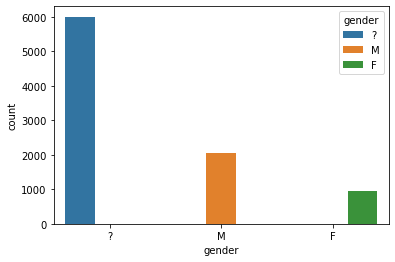

In [12]:
#plotted the number of male, female and unknown gender characters
sns.countplot(x="gender",data=df_character,hue="gender")

In [13]:
#we read the movie_lines file into a dataframe
df_lines= pd.read_excel("movie/movie_lines.xlsx")

In [14]:
#we added the column headings to the dataframe
df_lines.columns=["lineID","characterID","movieID","character name","text of the utterance"]

In [15]:
df_lines.head()

,lineID,characterID,movieID,character name,text of the utterance
0,L1044,u2,m0,CAMERON,They do to!
1,L985,u0,m0,BIANCA,I hope so.
2,L984,u2,m0,CAMERON,She okay?
3,L925,u0,m0,BIANCA,Let's go.
4,L924,u2,m0,CAMERON,Wow


In [16]:
#Joining the two dataframes on the basis of common columns "movie_id", "character_name" and character_id
df3=pd.merge(df_character,df_lines,on=['movieID','character name','characterID'],how="inner")

In [17]:
#we are displaying the first 5 records of the dataframe
df3.head()

,characterID,character name,movieID,movie title,gender,position in credits,lineID,text of the utterance
0,u1,BRUCE,m0,10 things i hate about you,?,?,L463,Just sent 'em through.
1,u1,BRUCE,m0,10 things i hate about you,?,?,L461,Never
2,u1,BRUCE,m0,10 things i hate about you,?,?,L459,Didn't have you pegged for a Gigglepuss fan. ...
3,u2,CAMERON,m0,10 things i hate about you,M,3,L1044,They do to!
4,u2,CAMERON,m0,10 things i hate about you,M,3,L984,She okay?


In [18]:
##### We converted the tab separated files to excel and reading the file with read_excel
df_movie=pd.read_excel("movie/movie_titles_metadata.xlsx")

In [19]:
df_movie.columns=['movieID', 'movie title','movie year','IMDB rating','IMDB votes','genre']

In [20]:
df_movie.head()

,movieID,movie title,movie year,IMDB rating,IMDB votes,genre
0,m1,1492: conquest of paradise,1992,6.2,10421.0,['adventure' 'biography' 'drama' 'history']
1,m2,15 minutes,2001,6.1,25854.0,['action' 'crime' 'drama' 'thriller']
2,m3,2001: a space odyssey,1968,8.4,163227.0,['adventure' 'mystery' 'sci-fi']
3,m4,48 hrs.,1982,6.9,22289.0,['action' 'comedy' 'crime' 'drama' 'thriller']
4,m5,the fifth element,1997,7.5,133756.0,['action' 'adventure' 'romance' 'sci-fi' 'thri...


In [21]:
#Joining the two dataframes with a third dataframe the basis of common columns "movie_id", "movie_title"
df_final=pd.merge(df3,df_movie,on=['movieID','movie title'],how="inner")

In [22]:
df_final.head()

,characterID,character name,movieID,movie title,gender,position in credits,lineID,text of the utterance,movie year,IMDB rating,IMDB votes,genre
0,u12,ALONSO,m1,1492: conquest of paradise,?,?,L2181,Can't be that far I say. Also I don't like th...,1992,6.2,10421.0,['adventure' 'biography' 'drama' 'history']
1,u12,ALONSO,m1,1492: conquest of paradise,?,?,L2179,We should have seen land.,1992,6.2,10421.0,['adventure' 'biography' 'drama' 'history']
2,u12,ALONSO,m1,1492: conquest of paradise,?,?,L2176,He's the devil's child...,1992,6.2,10421.0,['adventure' 'biography' 'drama' 'history']
3,u12,ALONSO,m1,1492: conquest of paradise,?,?,L2175,With a face like that? I don't want you looki...,1992,6.2,10421.0,['adventure' 'biography' 'drama' 'history']
4,u12,ALONSO,m1,1492: conquest of paradise,?,?,L2173,What are you listening to chicken ass?,1992,6.2,10421.0,['adventure' 'biography' 'drama' 'history']


In [23]:
#The genre column stores a collection of genres, we need to get the count of individual genres
df_final["genre"].value_counts()

['drama']                                           20779
['comedy' 'drama' 'romance']                        11468
['comedy' 'drama']                                  10690
['comedy' 'romance']                                 9704
['crime' 'drama' 'thriller']                         8652
                                                    ...  
['action' 'adventure' 'drama' 'history' 'war']         68
['short' 'adventure' 'drama' 'romance']                53
['crime' 'drama' 'history' 'mystery' 'thriller']       11
['action' 'drama' 'sci-fi']                             8
['comedy' 'fantasy' 'romance']                          5
Name: genre, Length: 289, dtype: int64

In [24]:
# We understand the data is stored as strings and not list
for i in (df_final["genre"]):
    print(i + "is"+ str(type(i)))

['adventure' 'biography' 'drama' 'history']is<class 'str'>
['adventure' 'biography' 'drama' 'history']is<class 'str'>
['adventure' 'biography' 'drama' 'history']is<class 'str'>
['adventure' 'biography' 'drama' 'history']is<class 'str'>
['adventure' 'biography' 'drama' 'history']is<class 'str'>
['adventure' 'biography' 'drama' 'history']is<class 'str'>
['adventure' 'biography' 'drama' 'history']is<class 'str'>
['adventure' 'biography' 'drama' 'history']is<class 'str'>
['adventure' 'biography' 'drama' 'history']is<class 'str'>
['adventure' 'biography' 'drama' 'history']is<class 'str'>
['adventure' 'biography' 'drama' 'history']is<class 'str'>
['adventure' 'biography' 'drama' 'history']is<class 'str'>
['adventure' 'biography' 'drama' 'history']is<class 'str'>
['adventure' 'biography' 'drama' 'history']is<class 'str'>
['adventure' 'biography' 'drama' 'history']is<class 'str'>
['adventure' 'biography' 'drama' 'history']is<class 'str'>
['adventure' 'biography' 'drama' 'history']is<class 'str

['action' 'comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['action

['fantasy' 'horror' 'thriller']is<class 'str'>
['fantasy' 'horror' 'thriller']is<class 'str'>
['fantasy' 'horror' 'thriller']is<class 'str'>
['fantasy' 'horror' 'thriller']is<class 'str'>
['fantasy' 'horror' 'thriller']is<class 'str'>
['fantasy' 'horror' 'thriller']is<class 'str'>
['fantasy' 'horror' 'thriller']is<class 'str'>
['fantasy' 'horror' 'thriller']is<class 'str'>
['fantasy' 'horror' 'thriller']is<class 'str'>
['fantasy' 'horror' 'thriller']is<class 'str'>
['fantasy' 'horror' 'thriller']is<class 'str'>
['fantasy' 'horror' 'thriller']is<class 'str'>
['fantasy' 'horror' 'thriller']is<class 'str'>
['fantasy' 'horror' 'thriller']is<class 'str'>
['fantasy' 'horror' 'thriller']is<class 'str'>
['fantasy' 'horror' 'thriller']is<class 'str'>
['fantasy' 'horror' 'thriller']is<class 'str'>
['fantasy' 'horror' 'thriller']is<class 'str'>
['fantasy' 'horror' 'thriller']is<class 'str'>
['fantasy' 'horror' 'thriller']is<class 'str'>
['fantasy' 'horror' 'thriller']is<class 'str'>
['fantasy' 'h

['comedy' 'romance' 'sci-fi']is<class 'str'>
['comedy' 'romance' 'sci-fi']is<class 'str'>
['comedy' 'romance' 'sci-fi']is<class 'str'>
['comedy' 'romance' 'sci-fi']is<class 'str'>
['comedy' 'romance' 'sci-fi']is<class 'str'>
['comedy' 'romance' 'sci-fi']is<class 'str'>
['comedy' 'romance' 'sci-fi']is<class 'str'>
['comedy' 'romance' 'sci-fi']is<class 'str'>
['comedy' 'romance' 'sci-fi']is<class 'str'>
['comedy' 'romance' 'sci-fi']is<class 'str'>
['comedy' 'romance' 'sci-fi']is<class 'str'>
['comedy' 'romance' 'sci-fi']is<class 'str'>
['comedy' 'romance' 'sci-fi']is<class 'str'>
['comedy' 'romance' 'sci-fi']is<class 'str'>
['comedy' 'romance' 'sci-fi']is<class 'str'>
['comedy' 'romance' 'sci-fi']is<class 'str'>
['comedy' 'romance' 'sci-fi']is<class 'str'>
['comedy' 'romance' 'sci-fi']is<class 'str'>
['comedy' 'romance' 'sci-fi']is<class 'str'>
['comedy' 'romance' 'sci-fi']is<class 'str'>
['comedy' 'romance' 'sci-fi']is<class 'str'>
['comedy' 'romance' 'sci-fi']is<class 'str'>
['comedy' 

['biography' 'drama' 'music']is<class 'str'>
['biography' 'drama' 'music']is<class 'str'>
['biography' 'drama' 'music']is<class 'str'>
['biography' 'drama' 'music']is<class 'str'>
['biography' 'drama' 'music']is<class 'str'>
['biography' 'drama' 'music']is<class 'str'>
['biography' 'drama' 'music']is<class 'str'>
['biography' 'drama' 'music']is<class 'str'>
['biography' 'drama' 'music']is<class 'str'>
['biography' 'drama' 'music']is<class 'str'>
['biography' 'drama' 'music']is<class 'str'>
['biography' 'drama' 'music']is<class 'str'>
['biography' 'drama' 'music']is<class 'str'>
['biography' 'drama' 'music']is<class 'str'>
['biography' 'drama' 'music']is<class 'str'>
['biography' 'drama' 'music']is<class 'str'>
['biography' 'drama' 'music']is<class 'str'>
['biography' 'drama' 'music']is<class 'str'>
['biography' 'drama' 'music']is<class 'str'>
['biography' 'drama' 'music']is<class 'str'>
['biography' 'drama' 'music']is<class 'str'>
['biography' 'drama' 'music']is<class 'str'>
['biograph

['horror' 'romance']is<class 'str'>
['horror' 'romance']is<class 'str'>
['horror' 'romance']is<class 'str'>
['horror' 'romance']is<class 'str'>
['horror' 'romance']is<class 'str'>
['horror' 'romance']is<class 'str'>
['horror' 'romance']is<class 'str'>
['horror' 'romance']is<class 'str'>
['horror' 'romance']is<class 'str'>
['horror' 'romance']is<class 'str'>
['horror' 'romance']is<class 'str'>
['horror' 'romance']is<class 'str'>
['horror' 'romance']is<class 'str'>
['horror' 'romance']is<class 'str'>
['horror' 'romance']is<class 'str'>
['horror' 'romance']is<class 'str'>
['horror' 'romance']is<class 'str'>
['horror' 'romance']is<class 'str'>
['horror' 'romance']is<class 'str'>
['horror' 'romance']is<class 'str'>
['horror' 'romance']is<class 'str'>
['horror' 'romance']is<class 'str'>
['horror' 'romance']is<class 'str'>
['horror' 'romance']is<class 'str'>
['horror' 'romance']is<class 'str'>
['horror' 'romance']is<class 'str'>
['horror' 'romance']is<class 'str'>
['horror' 'romance']is<class

['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class

['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['action' 'adventure' 'comedy' 'crime']is<class 'str'>
['action' 'adventure' 'comedy' 'crime']is<cla

['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class

['comedy' 'drama' 'music']is<class 'str'>
['comedy' 'drama' 'music']is<class 'str'>
['comedy' 'drama' 'music']is<class 'str'>
['comedy' 'drama' 'music']is<class 'str'>
['comedy' 'drama' 'music']is<class 'str'>
['comedy' 'drama' 'music']is<class 'str'>
['comedy' 'drama' 'music']is<class 'str'>
['comedy' 'drama' 'music']is<class 'str'>
['comedy' 'drama' 'music']is<class 'str'>
['comedy' 'drama' 'music']is<class 'str'>
['comedy' 'drama' 'music']is<class 'str'>
['comedy' 'drama' 'music']is<class 'str'>
['comedy' 'drama' 'music']is<class 'str'>
['comedy' 'drama' 'music']is<class 'str'>
['comedy' 'drama' 'music']is<class 'str'>
['comedy' 'drama' 'music']is<class 'str'>
['comedy' 'drama' 'music']is<class 'str'>
['comedy' 'drama' 'music']is<class 'str'>
['comedy' 'drama' 'music']is<class 'str'>
['comedy' 'drama' 'music']is<class 'str'>
['comedy' 'drama' 'music']is<class 'str'>
['comedy' 'drama' 'music']is<class 'str'>
['comedy' 'drama' 'music']is<class 'str'>
['comedy' 'drama' 'music']is<class

['crime' 'drama' 'mystery' 'thriller']is<class 'str'>
['crime' 'drama' 'mystery' 'thriller']is<class 'str'>
['crime' 'drama' 'mystery' 'thriller']is<class 'str'>
['crime' 'drama' 'mystery' 'thriller']is<class 'str'>
['crime' 'drama' 'mystery' 'thriller']is<class 'str'>
['crime' 'drama' 'mystery' 'thriller']is<class 'str'>
['crime' 'drama' 'mystery' 'thriller']is<class 'str'>
['crime' 'drama' 'mystery' 'thriller']is<class 'str'>
['crime' 'drama' 'mystery' 'thriller']is<class 'str'>
['crime' 'drama' 'mystery' 'thriller']is<class 'str'>
['crime' 'drama' 'mystery' 'thriller']is<class 'str'>
['crime' 'drama' 'mystery' 'thriller']is<class 'str'>
['crime' 'drama' 'mystery' 'thriller']is<class 'str'>
['crime' 'drama' 'mystery' 'thriller']is<class 'str'>
['crime' 'drama' 'mystery' 'thriller']is<class 'str'>
['crime' 'drama' 'mystery' 'thriller']is<class 'str'>
['crime' 'drama' 'mystery' 'thriller']is<class 'str'>
['crime' 'drama' 'mystery' 'thriller']is<class 'str'>
['crime' 'drama' 'mystery' '

['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>


['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<c

['crime' 'mystery' 'thriller']is<class 'str'>
['crime' 'mystery' 'thriller']is<class 'str'>
['crime' 'mystery' 'thriller']is<class 'str'>
['crime' 'mystery' 'thriller']is<class 'str'>
['crime' 'mystery' 'thriller']is<class 'str'>
['crime' 'mystery' 'thriller']is<class 'str'>
['crime' 'mystery' 'thriller']is<class 'str'>
['crime' 'mystery' 'thriller']is<class 'str'>
['crime' 'mystery' 'thriller']is<class 'str'>
['crime' 'mystery' 'thriller']is<class 'str'>
['crime' 'mystery' 'thriller']is<class 'str'>
['crime' 'mystery' 'thriller']is<class 'str'>
['crime' 'mystery' 'thriller']is<class 'str'>
['crime' 'mystery' 'thriller']is<class 'str'>
['crime' 'mystery' 'thriller']is<class 'str'>
['crime' 'mystery' 'thriller']is<class 'str'>
['crime' 'mystery' 'thriller']is<class 'str'>
['crime' 'mystery' 'thriller']is<class 'str'>
['crime' 'mystery' 'thriller']is<class 'str'>
['crime' 'mystery' 'thriller']is<class 'str'>
['crime' 'mystery' 'thriller']is<class 'str'>
['crime' 'mystery' 'thriller']is<c

['comedy' 'crime']is<class 'str'>
['comedy' 'crime']is<class 'str'>
['comedy' 'crime']is<class 'str'>
['comedy' 'crime']is<class 'str'>
['comedy' 'crime']is<class 'str'>
['comedy' 'crime']is<class 'str'>
['comedy' 'crime']is<class 'str'>
['comedy' 'crime']is<class 'str'>
['comedy' 'crime']is<class 'str'>
['comedy' 'crime']is<class 'str'>
['comedy' 'crime']is<class 'str'>
['comedy' 'crime']is<class 'str'>
['comedy' 'crime']is<class 'str'>
['comedy' 'crime']is<class 'str'>
['comedy' 'crime']is<class 'str'>
['comedy' 'crime']is<class 'str'>
['comedy' 'crime']is<class 'str'>
['comedy' 'crime']is<class 'str'>
['comedy' 'crime']is<class 'str'>
['comedy' 'crime']is<class 'str'>
['comedy' 'crime']is<class 'str'>
['comedy' 'crime']is<class 'str'>
['comedy' 'crime']is<class 'str'>
['comedy' 'crime']is<class 'str'>
['comedy' 'crime']is<class 'str'>
['comedy' 'crime']is<class 'str'>
['comedy' 'crime']is<class 'str'>
['comedy' 'crime']is<class 'str'>
['comedy' 'crime']is<class 'str'>
['comedy' 'cri

['action' 'biography' 'drama' 'history' 'war']is<class 'str'>
['action' 'biography' 'drama' 'history' 'war']is<class 'str'>
['action' 'biography' 'drama' 'history' 'war']is<class 'str'>
['action' 'biography' 'drama' 'history' 'war']is<class 'str'>
['action' 'biography' 'drama' 'history' 'war']is<class 'str'>
['action' 'biography' 'drama' 'history' 'war']is<class 'str'>
['action' 'biography' 'drama' 'history' 'war']is<class 'str'>
['action' 'biography' 'drama' 'history' 'war']is<class 'str'>
['action' 'biography' 'drama' 'history' 'war']is<class 'str'>
['action' 'biography' 'drama' 'history' 'war']is<class 'str'>
['action' 'biography' 'drama' 'history' 'war']is<class 'str'>
['action' 'biography' 'drama' 'history' 'war']is<class 'str'>
['action' 'biography' 'drama' 'history' 'war']is<class 'str'>
['action' 'biography' 'drama' 'history' 'war']is<class 'str'>
['action' 'biography' 'drama' 'history' 'war']is<class 'str'>
['action' 'biography' 'drama' 'history' 'war']is<class 'str'>
['action

['drama' 'romance' 'war']is<class 'str'>
['drama' 'romance' 'war']is<class 'str'>
['drama' 'romance' 'war']is<class 'str'>
['drama' 'romance' 'war']is<class 'str'>
['drama' 'romance' 'war']is<class 'str'>
['drama' 'romance' 'war']is<class 'str'>
['drama' 'romance' 'war']is<class 'str'>
['drama' 'romance' 'war']is<class 'str'>
['drama' 'romance' 'war']is<class 'str'>
['drama' 'romance' 'war']is<class 'str'>
['drama' 'romance' 'war']is<class 'str'>
['drama' 'romance' 'war']is<class 'str'>
['drama' 'romance' 'war']is<class 'str'>
['drama' 'romance' 'war']is<class 'str'>
['drama' 'romance' 'war']is<class 'str'>
['drama' 'romance' 'war']is<class 'str'>
['drama' 'romance' 'war']is<class 'str'>
['drama' 'romance' 'war']is<class 'str'>
['drama' 'romance' 'war']is<class 'str'>
['drama' 'romance' 'war']is<class 'str'>
['drama' 'romance' 'war']is<class 'str'>
['drama' 'romance' 'war']is<class 'str'>
['drama' 'romance' 'war']is<class 'str'>
['drama' 'romance' 'war']is<class 'str'>
['drama' 'romanc

['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class

['comedy' 'sci-fi' 'thriller']is<class 'str'>
['comedy' 'sci-fi' 'thriller']is<class 'str'>
['comedy' 'sci-fi' 'thriller']is<class 'str'>
['comedy' 'sci-fi' 'thriller']is<class 'str'>
['comedy' 'sci-fi' 'thriller']is<class 'str'>
['comedy' 'sci-fi' 'thriller']is<class 'str'>
['comedy' 'sci-fi' 'thriller']is<class 'str'>
['comedy' 'sci-fi' 'thriller']is<class 'str'>
['comedy' 'sci-fi' 'thriller']is<class 'str'>
['comedy' 'sci-fi' 'thriller']is<class 'str'>
['comedy' 'sci-fi' 'thriller']is<class 'str'>
['comedy' 'sci-fi' 'thriller']is<class 'str'>
['comedy' 'sci-fi' 'thriller']is<class 'str'>
['comedy' 'sci-fi' 'thriller']is<class 'str'>
['comedy' 'sci-fi' 'thriller']is<class 'str'>
['comedy' 'sci-fi' 'thriller']is<class 'str'>
['comedy' 'sci-fi' 'thriller']is<class 'str'>
['comedy' 'sci-fi' 'thriller']is<class 'str'>
['comedy' 'sci-fi' 'thriller']is<class 'str'>
['comedy' 'sci-fi' 'thriller']is<class 'str'>
['comedy' 'sci-fi' 'thriller']is<class 'str'>
['comedy' 'sci-fi' 'thriller']is<c

['drama' 'mystery' 'sci-fi']is<class 'str'>
['drama' 'mystery' 'sci-fi']is<class 'str'>
['drama' 'mystery' 'sci-fi']is<class 'str'>
['drama' 'mystery' 'sci-fi']is<class 'str'>
['drama' 'mystery' 'sci-fi']is<class 'str'>
['drama' 'mystery' 'sci-fi']is<class 'str'>
['drama' 'mystery' 'sci-fi']is<class 'str'>
['drama' 'mystery' 'sci-fi']is<class 'str'>
['drama' 'mystery' 'sci-fi']is<class 'str'>
['drama' 'mystery' 'sci-fi']is<class 'str'>
['drama' 'mystery' 'sci-fi']is<class 'str'>
['drama' 'mystery' 'sci-fi']is<class 'str'>
['drama' 'mystery' 'sci-fi']is<class 'str'>
['drama' 'mystery' 'sci-fi']is<class 'str'>
['drama' 'mystery' 'sci-fi']is<class 'str'>
['drama' 'mystery' 'sci-fi']is<class 'str'>
['drama' 'mystery' 'sci-fi']is<class 'str'>
['drama' 'mystery' 'sci-fi']is<class 'str'>
['drama' 'mystery' 'sci-fi']is<class 'str'>
['drama' 'mystery' 'sci-fi']is<class 'str'>
['drama' 'mystery' 'sci-fi']is<class 'str'>
['drama' 'mystery' 'sci-fi']is<class 'str'>
['drama' 'mystery' 'sci-fi']is<c

['biography' 'drama' 'history']is<class 'str'>
['biography' 'drama' 'history']is<class 'str'>
['biography' 'drama' 'history']is<class 'str'>
['biography' 'drama' 'history']is<class 'str'>
['biography' 'drama' 'history']is<class 'str'>
['biography' 'drama' 'history']is<class 'str'>
['biography' 'drama' 'history']is<class 'str'>
['biography' 'drama' 'history']is<class 'str'>
['biography' 'drama' 'history']is<class 'str'>
['biography' 'drama' 'history']is<class 'str'>
['biography' 'drama' 'history']is<class 'str'>
['biography' 'drama' 'history']is<class 'str'>
['biography' 'drama' 'history']is<class 'str'>
['biography' 'drama' 'history']is<class 'str'>
['biography' 'drama' 'history']is<class 'str'>
['biography' 'drama' 'history']is<class 'str'>
['biography' 'drama' 'history']is<class 'str'>
['biography' 'drama' 'history']is<class 'str'>
['biography' 'drama' 'history']is<class 'str'>
['biography' 'drama' 'history']is<class 'str'>
['biography' 'drama' 'history']is<class 'str'>
['biography' 

['drama' 'romance' 'sci-fi']is<class 'str'>
['drama' 'romance' 'sci-fi']is<class 'str'>
['drama' 'romance' 'sci-fi']is<class 'str'>
['drama' 'romance' 'sci-fi']is<class 'str'>
['drama' 'romance' 'sci-fi']is<class 'str'>
['drama' 'romance' 'sci-fi']is<class 'str'>
['drama' 'romance' 'sci-fi']is<class 'str'>
['drama' 'romance' 'sci-fi']is<class 'str'>
['drama' 'romance' 'sci-fi']is<class 'str'>
['drama' 'romance' 'sci-fi']is<class 'str'>
['drama' 'romance' 'sci-fi']is<class 'str'>
['drama' 'romance' 'sci-fi']is<class 'str'>
['drama' 'romance' 'sci-fi']is<class 'str'>
['drama' 'romance' 'sci-fi']is<class 'str'>
['drama' 'romance' 'sci-fi']is<class 'str'>
['drama' 'romance' 'sci-fi']is<class 'str'>
['drama' 'romance' 'sci-fi']is<class 'str'>
['drama' 'romance' 'sci-fi']is<class 'str'>
['drama' 'romance' 'sci-fi']is<class 'str'>
['drama' 'romance' 'sci-fi']is<class 'str'>
['drama' 'romance' 'sci-fi']is<class 'str'>
['drama' 'romance' 'sci-fi']is<class 'str'>
['drama' 'romance' 'sci-fi']is<c

['action' 'adventure' 'fantasy' 'sci-fi' 'fantasy']is<class 'str'>
['action' 'adventure' 'fantasy' 'sci-fi' 'fantasy']is<class 'str'>
['action' 'adventure' 'fantasy' 'sci-fi' 'fantasy']is<class 'str'>
['action' 'adventure' 'fantasy' 'sci-fi' 'fantasy']is<class 'str'>
['action' 'adventure' 'fantasy' 'sci-fi' 'fantasy']is<class 'str'>
['action' 'adventure' 'fantasy' 'sci-fi' 'fantasy']is<class 'str'>
['action' 'adventure' 'fantasy' 'sci-fi' 'fantasy']is<class 'str'>
['action' 'adventure' 'fantasy' 'sci-fi' 'fantasy']is<class 'str'>
['action' 'adventure' 'fantasy' 'sci-fi' 'fantasy']is<class 'str'>
['action' 'adventure' 'fantasy' 'sci-fi' 'fantasy']is<class 'str'>
['action' 'adventure' 'fantasy' 'sci-fi' 'fantasy']is<class 'str'>
['action' 'adventure' 'fantasy' 'sci-fi' 'fantasy']is<class 'str'>
['action' 'adventure' 'fantasy' 'sci-fi' 'fantasy']is<class 'str'>
['action' 'adventure' 'fantasy' 'sci-fi' 'fantasy']is<class 'str'>
['action' 'adventure' 'fantasy' 'sci-fi' 'fantasy']is<class 's

['action' 'comedy' 'horror' 'thriller']is<class 'str'>
['action' 'comedy' 'horror' 'thriller']is<class 'str'>
['action' 'comedy' 'horror' 'thriller']is<class 'str'>
['action' 'comedy' 'horror' 'thriller']is<class 'str'>
['action' 'comedy' 'horror' 'thriller']is<class 'str'>
['action' 'comedy' 'horror' 'thriller']is<class 'str'>
['action' 'comedy' 'horror' 'thriller']is<class 'str'>
['action' 'comedy' 'horror' 'thriller']is<class 'str'>
['action' 'comedy' 'horror' 'thriller']is<class 'str'>
['action' 'comedy' 'horror' 'thriller']is<class 'str'>
['action' 'comedy' 'horror' 'thriller']is<class 'str'>
['action' 'comedy' 'horror' 'thriller']is<class 'str'>
['action' 'comedy' 'horror' 'thriller']is<class 'str'>
['action' 'comedy' 'horror' 'thriller']is<class 'str'>
['action' 'comedy' 'horror' 'thriller']is<class 'str'>
['action' 'comedy' 'horror' 'thriller']is<class 'str'>
['action' 'comedy' 'horror' 'thriller']is<class 'str'>
['action' 'comedy' 'horror' 'thriller']is<class 'str'>
['action' 

['drama' 'horror' 'sci-fi']is<class 'str'>
['drama' 'horror' 'sci-fi']is<class 'str'>
['drama' 'horror' 'sci-fi']is<class 'str'>
['drama' 'horror' 'sci-fi']is<class 'str'>
['drama' 'horror' 'sci-fi']is<class 'str'>
['drama' 'horror' 'sci-fi']is<class 'str'>
['drama' 'horror' 'sci-fi']is<class 'str'>
['drama' 'horror' 'sci-fi']is<class 'str'>
['drama' 'horror' 'sci-fi']is<class 'str'>
['drama' 'horror' 'sci-fi']is<class 'str'>
['drama' 'horror' 'sci-fi']is<class 'str'>
['drama' 'horror' 'sci-fi']is<class 'str'>
['drama' 'horror' 'sci-fi']is<class 'str'>
['drama' 'horror' 'sci-fi']is<class 'str'>
['drama' 'horror' 'sci-fi']is<class 'str'>
['drama' 'horror' 'sci-fi']is<class 'str'>
['drama' 'horror' 'sci-fi']is<class 'str'>
['drama' 'horror' 'sci-fi']is<class 'str'>
['drama' 'horror' 'sci-fi']is<class 'str'>
['drama' 'horror' 'sci-fi']is<class 'str'>
['drama' 'horror' 'sci-fi']is<class 'str'>
['drama' 'horror' 'sci-fi']is<class 'str'>
['drama' 'horror' 'sci-fi']is<class 'str'>
['drama' 'h

['action' 'drama']is<class 'str'>
['action' 'drama']is<class 'str'>
['action' 'drama']is<class 'str'>
['action' 'drama']is<class 'str'>
['action' 'drama']is<class 'str'>
['action' 'drama']is<class 'str'>
['action' 'drama']is<class 'str'>
['action' 'drama']is<class 'str'>
['action' 'drama']is<class 'str'>
['action' 'drama']is<class 'str'>
['action' 'drama']is<class 'str'>
['action' 'drama']is<class 'str'>
['action' 'drama']is<class 'str'>
['action' 'drama']is<class 'str'>
['action' 'drama']is<class 'str'>
['action' 'drama']is<class 'str'>
['action' 'drama']is<class 'str'>
['action' 'drama']is<class 'str'>
['action' 'drama']is<class 'str'>
['action' 'drama']is<class 'str'>
['action' 'drama']is<class 'str'>
['action' 'drama']is<class 'str'>
['action' 'drama']is<class 'str'>
['action' 'drama']is<class 'str'>
['action' 'drama']is<class 'str'>
['action' 'drama']is<class 'str'>
['action' 'drama']is<class 'str'>
['action' 'drama']is<class 'str'>
['action' 'drama']is<class 'str'>
['action' 'dra

['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>


['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'my

['adventure' 'drama' 'thriller']is<class 'str'>
['adventure' 'drama' 'thriller']is<class 'str'>
['adventure' 'drama' 'thriller']is<class 'str'>
['adventure' 'drama' 'thriller']is<class 'str'>
['adventure' 'drama' 'thriller']is<class 'str'>
['adventure' 'drama' 'thriller']is<class 'str'>
['adventure' 'drama' 'thriller']is<class 'str'>
['adventure' 'drama' 'thriller']is<class 'str'>
['adventure' 'drama' 'thriller']is<class 'str'>
['adventure' 'drama' 'thriller']is<class 'str'>
['adventure' 'drama' 'thriller']is<class 'str'>
['adventure' 'drama' 'thriller']is<class 'str'>
['adventure' 'drama' 'thriller']is<class 'str'>
['adventure' 'drama' 'thriller']is<class 'str'>
['adventure' 'drama' 'thriller']is<class 'str'>
['adventure' 'drama' 'thriller']is<class 'str'>
['adventure' 'drama' 'thriller']is<class 'str'>
['adventure' 'drama' 'thriller']is<class 'str'>
['adventure' 'drama' 'thriller']is<class 'str'>
['adventure' 'drama' 'thriller']is<class 'str'>
['adventure' 'drama' 'thriller']is<class

['action' 'adventure' 'drama']is<class 'str'>
['action' 'adventure' 'drama']is<class 'str'>
['action' 'adventure' 'drama']is<class 'str'>
['action' 'adventure' 'drama']is<class 'str'>
['action' 'adventure' 'drama']is<class 'str'>
['action' 'adventure' 'drama']is<class 'str'>
['action' 'adventure' 'drama']is<class 'str'>
['action' 'adventure' 'drama']is<class 'str'>
['action' 'adventure' 'drama']is<class 'str'>
['action' 'adventure' 'drama']is<class 'str'>
['action' 'adventure' 'drama']is<class 'str'>
['action' 'adventure' 'drama']is<class 'str'>
['action' 'adventure' 'drama']is<class 'str'>
['action' 'adventure' 'drama']is<class 'str'>
['action' 'adventure' 'drama']is<class 'str'>
['action' 'adventure' 'drama']is<class 'str'>
['action' 'adventure' 'drama']is<class 'str'>
['action' 'adventure' 'drama']is<class 'str'>
['action' 'adventure' 'drama']is<class 'str'>
['action' 'adventure' 'drama']is<class 'str'>
['action' 'adventure' 'drama']is<class 'str'>
['action' 'adventure' 'drama']is<c

['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']i

['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<c

['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'dra

['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class

['comedy' 'drama' 'music' 'romance']is<class 'str'>
['comedy' 'drama' 'music' 'romance']is<class 'str'>
['comedy' 'drama' 'music' 'romance']is<class 'str'>
['comedy' 'drama' 'music' 'romance']is<class 'str'>
['comedy' 'drama' 'music' 'romance']is<class 'str'>
['comedy' 'drama' 'music' 'romance']is<class 'str'>
['comedy' 'drama' 'music' 'romance']is<class 'str'>
['comedy' 'drama' 'music' 'romance']is<class 'str'>
['comedy' 'drama' 'music' 'romance']is<class 'str'>
['comedy' 'drama' 'music' 'romance']is<class 'str'>
['comedy' 'drama' 'music' 'romance']is<class 'str'>
['comedy' 'drama' 'music' 'romance']is<class 'str'>
['comedy' 'drama' 'music' 'romance']is<class 'str'>
['comedy' 'drama' 'music' 'romance']is<class 'str'>
['comedy' 'drama' 'music' 'romance']is<class 'str'>
['comedy' 'drama' 'music' 'romance']is<class 'str'>
['comedy' 'drama' 'music' 'romance']is<class 'str'>
['comedy' 'drama' 'music' 'romance']is<class 'str'>
['comedy' 'drama' 'music' 'romance']is<class 'str'>
['comedy' 'd

['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<c

['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['horror']is<class 'str'>
['horror']is<class 'str'>
['horror']is<class 'str'>
['horror']is<class 'str'>
['horror']is<class 'str'>
['horror']is<class 'str'>
['horror']is<class 'str'>
['horror']is<class 'str'>
['horror']is<class 'str'>
['horror']is<class 'str'>
['horror']is<class 'str'>
['horror']is<class 'str'>
['horror']is<class 'str'>
['horror']is<class 'str'>
['horror']is<class 'str'>
['horror']is<class 'str'>
['horror']is<class 'str'>
['horror']is<class 'str'>
['horror']is<class 'str'>
['horror']is<class 'str'>
['horror']is<class 'str'>
['horror']is<class 'str'>
['horror']is<class 'str'>
['horror']is<class 'str'>
['horror']is<class 'str'>
['horror']is<class 'str'>
['horror']is<class 'str'>
['horror']is<class 

['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'r

['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adv

['action' 'adventure' 'comedy' 'crime' 'sci-fi']is<class 'str'>
['action' 'adventure' 'comedy' 'crime' 'sci-fi']is<class 'str'>
['action' 'adventure' 'comedy' 'crime' 'sci-fi']is<class 'str'>
['action' 'adventure' 'comedy' 'crime' 'sci-fi']is<class 'str'>
['action' 'adventure' 'comedy' 'crime' 'sci-fi']is<class 'str'>
['action' 'adventure' 'comedy' 'crime' 'sci-fi']is<class 'str'>
['action' 'adventure' 'comedy' 'crime' 'sci-fi']is<class 'str'>
['action' 'adventure' 'comedy' 'crime' 'sci-fi']is<class 'str'>
['action' 'adventure' 'comedy' 'crime' 'sci-fi']is<class 'str'>
['action' 'adventure' 'comedy' 'crime' 'sci-fi']is<class 'str'>
['action' 'adventure' 'comedy' 'crime' 'sci-fi']is<class 'str'>
['action' 'adventure' 'comedy' 'crime' 'sci-fi']is<class 'str'>
['action' 'adventure' 'comedy' 'crime' 'sci-fi']is<class 'str'>
['action' 'adventure' 'comedy' 'crime' 'sci-fi']is<class 'str'>
['action' 'adventure' 'comedy' 'crime' 'sci-fi']is<class 'str'>
['action' 'adventure' 'comedy' 'crime' '

['biography' 'drama' 'thriller']is<class 'str'>
['biography' 'drama' 'thriller']is<class 'str'>
['biography' 'drama' 'thriller']is<class 'str'>
['biography' 'drama' 'thriller']is<class 'str'>
['biography' 'drama' 'thriller']is<class 'str'>
['biography' 'drama' 'thriller']is<class 'str'>
['biography' 'drama' 'thriller']is<class 'str'>
['biography' 'drama' 'thriller']is<class 'str'>
['biography' 'drama' 'thriller']is<class 'str'>
['biography' 'drama' 'thriller']is<class 'str'>
['biography' 'drama' 'thriller']is<class 'str'>
['biography' 'drama' 'thriller']is<class 'str'>
['biography' 'drama' 'thriller']is<class 'str'>
['biography' 'drama' 'thriller']is<class 'str'>
['biography' 'drama' 'thriller']is<class 'str'>
['biography' 'drama' 'thriller']is<class 'str'>
['biography' 'drama' 'thriller']is<class 'str'>
['biography' 'drama' 'thriller']is<class 'str'>
['biography' 'drama' 'thriller']is<class 'str'>
['biography' 'drama' 'thriller']is<class 'str'>
['biography' 'drama' 'thriller']is<class

['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class

['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<c

['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<c

['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class

['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<c

['mystery' 'thriller']is<class 'str'>
['mystery' 'thriller']is<class 'str'>
['mystery' 'thriller']is<class 'str'>
['mystery' 'thriller']is<class 'str'>
['mystery' 'thriller']is<class 'str'>
['mystery' 'thriller']is<class 'str'>
['mystery' 'thriller']is<class 'str'>
['mystery' 'thriller']is<class 'str'>
['mystery' 'thriller']is<class 'str'>
['mystery' 'thriller']is<class 'str'>
['mystery' 'thriller']is<class 'str'>
['mystery' 'thriller']is<class 'str'>
['mystery' 'thriller']is<class 'str'>
['mystery' 'thriller']is<class 'str'>
['mystery' 'thriller']is<class 'str'>
['mystery' 'thriller']is<class 'str'>
['mystery' 'thriller']is<class 'str'>
['mystery' 'thriller']is<class 'str'>
['mystery' 'thriller']is<class 'str'>
['mystery' 'thriller']is<class 'str'>
['mystery' 'thriller']is<class 'str'>
['mystery' 'thriller']is<class 'str'>
['mystery' 'thriller']is<class 'str'>
['mystery' 'thriller']is<class 'str'>
['mystery' 'thriller']is<class 'str'>
['mystery' 'thriller']is<class 'str'>
['mystery' '

['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>


['fantasy' 'adventure' 'romance']is<class 'str'>
['fantasy' 'adventure' 'romance']is<class 'str'>
['fantasy' 'adventure' 'romance']is<class 'str'>
['fantasy' 'adventure' 'romance']is<class 'str'>
['fantasy' 'adventure' 'romance']is<class 'str'>
['fantasy' 'adventure' 'romance']is<class 'str'>
['fantasy' 'adventure' 'romance']is<class 'str'>
['fantasy' 'adventure' 'romance']is<class 'str'>
['fantasy' 'adventure' 'romance']is<class 'str'>
['fantasy' 'adventure' 'romance']is<class 'str'>
['fantasy' 'adventure' 'romance']is<class 'str'>
['fantasy' 'adventure' 'romance']is<class 'str'>
['fantasy' 'adventure' 'romance']is<class 'str'>
['fantasy' 'adventure' 'romance']is<class 'str'>
['fantasy' 'adventure' 'romance']is<class 'str'>
['fantasy' 'adventure' 'romance']is<class 'str'>
['fantasy' 'adventure' 'romance']is<class 'str'>
['fantasy' 'adventure' 'romance']is<class 'str'>
['fantasy' 'adventure' 'romance']is<class 'str'>
['fantasy' 'adventure' 'romance']is<class 'str'>
['fantasy' 'adventur

['drama' 'crime' 'thriller']is<class 'str'>
['drama' 'crime' 'thriller']is<class 'str'>
['drama' 'crime' 'thriller']is<class 'str'>
['drama' 'crime' 'thriller']is<class 'str'>
['drama' 'crime' 'thriller']is<class 'str'>
['drama' 'crime' 'thriller']is<class 'str'>
['drama' 'crime' 'thriller']is<class 'str'>
['drama' 'crime' 'thriller']is<class 'str'>
['drama' 'crime' 'thriller']is<class 'str'>
['drama' 'crime' 'thriller']is<class 'str'>
['drama' 'crime' 'thriller']is<class 'str'>
['drama' 'crime' 'thriller']is<class 'str'>
['drama' 'crime' 'thriller']is<class 'str'>
['drama' 'crime' 'thriller']is<class 'str'>
['drama' 'crime' 'thriller']is<class 'str'>
['drama' 'crime' 'thriller']is<class 'str'>
['drama' 'crime' 'thriller']is<class 'str'>
['drama' 'crime' 'thriller']is<class 'str'>
['drama' 'crime' 'thriller']is<class 'str'>
['drama' 'crime' 'thriller']is<class 'str'>
['drama' 'crime' 'thriller']is<class 'str'>
['drama' 'crime' 'thriller']is<class 'str'>
['drama' 'crime' 'thriller']is<c

['drama' 'horror' 'mystery' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'thriller']is<class 'str'>
['drama' '

['action' 'adventure' 'comedy' 'sci-fi']is<class 'str'>
['action' 'adventure' 'comedy' 'sci-fi']is<class 'str'>
['action' 'adventure' 'comedy' 'sci-fi']is<class 'str'>
['action' 'adventure' 'comedy' 'sci-fi']is<class 'str'>
['action' 'adventure' 'comedy' 'sci-fi']is<class 'str'>
['action' 'adventure' 'comedy' 'sci-fi']is<class 'str'>
['action' 'adventure' 'comedy' 'sci-fi']is<class 'str'>
['action' 'adventure' 'comedy' 'sci-fi']is<class 'str'>
['action' 'adventure' 'comedy' 'sci-fi']is<class 'str'>
['action' 'adventure' 'comedy' 'sci-fi']is<class 'str'>
['action' 'adventure' 'comedy' 'sci-fi']is<class 'str'>
['action' 'adventure' 'comedy' 'sci-fi']is<class 'str'>
['action' 'adventure' 'comedy' 'sci-fi']is<class 'str'>
['action' 'adventure' 'comedy' 'sci-fi']is<class 'str'>
['action' 'adventure' 'comedy' 'sci-fi']is<class 'str'>
['action' 'adventure' 'comedy' 'sci-fi']is<class 'str'>
['action' 'adventure' 'comedy' 'sci-fi']is<class 'str'>
['action' 'adventure' 'comedy' 'sci-fi']is<class

['comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['comedy' 'crime' 'drama' 'thriller']is<class 

['biography' 'drama' 'history']is<class 'str'>
['biography' 'drama' 'history']is<class 'str'>
['biography' 'drama' 'history']is<class 'str'>
['biography' 'drama' 'history']is<class 'str'>
['biography' 'drama' 'history']is<class 'str'>
['biography' 'drama' 'history']is<class 'str'>
['biography' 'drama' 'history']is<class 'str'>
['biography' 'drama' 'history']is<class 'str'>
['biography' 'drama' 'history']is<class 'str'>
['biography' 'drama' 'history']is<class 'str'>
['biography' 'drama' 'history']is<class 'str'>
['biography' 'drama' 'history']is<class 'str'>
['biography' 'drama' 'history']is<class 'str'>
['biography' 'drama' 'history']is<class 'str'>
['biography' 'drama' 'history']is<class 'str'>
['biography' 'drama' 'history']is<class 'str'>
['biography' 'drama' 'history']is<class 'str'>
['biography' 'drama' 'history']is<class 'str'>
['biography' 'drama' 'history']is<class 'str'>
['biography' 'drama' 'history']is<class 'str'>
['biography' 'drama' 'history']is<class 'str'>
['biography' 

['comedy' 'war' 'drama']is<class 'str'>
['comedy' 'war' 'drama']is<class 'str'>
['comedy' 'war' 'drama']is<class 'str'>
['comedy' 'war' 'drama']is<class 'str'>
['comedy' 'war' 'drama']is<class 'str'>
['comedy' 'war' 'drama']is<class 'str'>
['comedy' 'war' 'drama']is<class 'str'>
['comedy' 'war' 'drama']is<class 'str'>
['comedy' 'war' 'drama']is<class 'str'>
['comedy' 'war' 'drama']is<class 'str'>
['comedy' 'war' 'drama']is<class 'str'>
['comedy' 'war' 'drama']is<class 'str'>
['comedy' 'war' 'drama']is<class 'str'>
['comedy' 'war' 'drama']is<class 'str'>
['comedy' 'war' 'drama']is<class 'str'>
['comedy' 'war' 'drama']is<class 'str'>
['comedy' 'war' 'drama']is<class 'str'>
['comedy' 'war' 'drama']is<class 'str'>
['comedy' 'war' 'drama']is<class 'str'>
['comedy' 'war' 'drama']is<class 'str'>
['comedy' 'war' 'drama']is<class 'str'>
['comedy' 'war' 'drama']is<class 'str'>
['comedy' 'war' 'drama']is<class 'str'>
['comedy' 'war' 'drama']is<class 'str'>
['comedy' 'war' 'drama']is<class 'str'>


['action' 'comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['action

['animation' 'comedy' 'fantasy' 'romance']is<class 'str'>
['animation' 'comedy' 'fantasy' 'romance']is<class 'str'>
['animation' 'comedy' 'fantasy' 'romance']is<class 'str'>
['animation' 'comedy' 'fantasy' 'romance']is<class 'str'>
['animation' 'comedy' 'fantasy' 'romance']is<class 'str'>
['animation' 'comedy' 'fantasy' 'romance']is<class 'str'>
['animation' 'comedy' 'fantasy' 'romance']is<class 'str'>
['animation' 'comedy' 'fantasy' 'romance']is<class 'str'>
['animation' 'comedy' 'fantasy' 'romance']is<class 'str'>
['animation' 'comedy' 'fantasy' 'romance']is<class 'str'>
['animation' 'comedy' 'fantasy' 'romance']is<class 'str'>
['animation' 'comedy' 'fantasy' 'romance']is<class 'str'>
['animation' 'comedy' 'fantasy' 'romance']is<class 'str'>
['animation' 'comedy' 'fantasy' 'romance']is<class 'str'>
['animation' 'comedy' 'fantasy' 'romance']is<class 'str'>
['animation' 'comedy' 'fantasy' 'romance']is<class 'str'>
['animation' 'comedy' 'fantasy' 'romance']is<class 'str'>
['animation' '

['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class

['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'dra

['family' 'adventure']is<class 'str'>
['family' 'adventure']is<class 'str'>
['family' 'adventure']is<class 'str'>
['family' 'adventure']is<class 'str'>
['family' 'adventure']is<class 'str'>
['family' 'adventure']is<class 'str'>
['family' 'adventure']is<class 'str'>
['family' 'adventure']is<class 'str'>
['family' 'adventure']is<class 'str'>
['family' 'adventure']is<class 'str'>
['family' 'adventure']is<class 'str'>
['family' 'adventure']is<class 'str'>
['family' 'adventure']is<class 'str'>
['family' 'adventure']is<class 'str'>
['family' 'adventure']is<class 'str'>
['family' 'adventure']is<class 'str'>
['family' 'adventure']is<class 'str'>
['family' 'adventure']is<class 'str'>
['family' 'adventure']is<class 'str'>
['family' 'adventure']is<class 'str'>
['family' 'adventure']is<class 'str'>
['family' 'adventure']is<class 'str'>
['family' 'adventure']is<class 'str'>
['family' 'adventure']is<class 'str'>
['family' 'adventure']is<class 'str'>
['family' 'adventure']is<class 'str'>
['family' 'a

['drama' 'film-noir' 'thriller']is<class 'str'>
['drama' 'film-noir' 'thriller']is<class 'str'>
['drama' 'film-noir' 'thriller']is<class 'str'>
['drama' 'film-noir' 'thriller']is<class 'str'>
['drama' 'film-noir' 'thriller']is<class 'str'>
['drama' 'film-noir' 'thriller']is<class 'str'>
['drama' 'film-noir' 'thriller']is<class 'str'>
['drama' 'film-noir' 'thriller']is<class 'str'>
['drama' 'film-noir' 'thriller']is<class 'str'>
['drama' 'film-noir' 'thriller']is<class 'str'>
['drama' 'film-noir' 'thriller']is<class 'str'>
['drama' 'film-noir' 'thriller']is<class 'str'>
['drama' 'film-noir' 'thriller']is<class 'str'>
['drama' 'film-noir' 'thriller']is<class 'str'>
['drama' 'film-noir' 'thriller']is<class 'str'>
['drama' 'film-noir' 'thriller']is<class 'str'>
['drama' 'film-noir' 'thriller']is<class 'str'>
['drama' 'film-noir' 'thriller']is<class 'str'>
['drama' 'film-noir' 'thriller']is<class 'str'>
['drama' 'film-noir' 'thriller']is<class 'str'>
['drama' 'film-noir' 'thriller']is<class

['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class

['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
[

['comedy' 'crime' 'romance' 'thriller']is<class 'str'>
['comedy' 'crime' 'romance' 'thriller']is<class 'str'>
['comedy' 'crime' 'romance' 'thriller']is<class 'str'>
['comedy' 'crime' 'romance' 'thriller']is<class 'str'>
['comedy' 'crime' 'romance' 'thriller']is<class 'str'>
['comedy' 'crime' 'romance' 'thriller']is<class 'str'>
['comedy' 'crime' 'romance' 'thriller']is<class 'str'>
['comedy' 'crime' 'romance' 'thriller']is<class 'str'>
['comedy' 'crime' 'romance' 'thriller']is<class 'str'>
['comedy' 'crime' 'romance' 'thriller']is<class 'str'>
['comedy' 'crime' 'romance' 'thriller']is<class 'str'>
['comedy' 'crime' 'romance' 'thriller']is<class 'str'>
['comedy' 'crime' 'romance' 'thriller']is<class 'str'>
['comedy' 'crime' 'romance' 'thriller']is<class 'str'>
['comedy' 'crime' 'romance' 'thriller']is<class 'str'>
['comedy' 'crime' 'romance' 'thriller']is<class 'str'>
['comedy' 'crime' 'romance' 'thriller']is<class 'str'>
['comedy' 'crime' 'romance' 'thriller']is<class 'str'>
['comedy' 

['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class

['adventure' 'fantasy' 'horror']is<class 'str'>
['adventure' 'fantasy' 'horror']is<class 'str'>
['adventure' 'fantasy' 'horror']is<class 'str'>
['adventure' 'fantasy' 'horror']is<class 'str'>
['adventure' 'fantasy' 'horror']is<class 'str'>
['adventure' 'fantasy' 'horror']is<class 'str'>
['adventure' 'fantasy' 'horror']is<class 'str'>
['adventure' 'fantasy' 'horror']is<class 'str'>
['adventure' 'fantasy' 'horror']is<class 'str'>
['adventure' 'fantasy' 'horror']is<class 'str'>
['adventure' 'fantasy' 'horror']is<class 'str'>
['adventure' 'fantasy' 'horror']is<class 'str'>
['adventure' 'fantasy' 'horror']is<class 'str'>
['adventure' 'fantasy' 'horror']is<class 'str'>
['adventure' 'fantasy' 'horror']is<class 'str'>
['adventure' 'fantasy' 'horror']is<class 'str'>
['adventure' 'fantasy' 'horror']is<class 'str'>
['adventure' 'fantasy' 'horror']is<class 'str'>
['adventure' 'fantasy' 'horror']is<class 'str'>
['adventure' 'fantasy' 'horror']is<class 'str'>
['adventure' 'fantasy' 'horror']is<class

['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class

['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<c

['biography' 'drama' 'sport']is<class 'str'>
['biography' 'drama' 'sport']is<class 'str'>
['biography' 'drama' 'sport']is<class 'str'>
['biography' 'drama' 'sport']is<class 'str'>
['biography' 'drama' 'sport']is<class 'str'>
['biography' 'drama' 'sport']is<class 'str'>
['biography' 'drama' 'sport']is<class 'str'>
['biography' 'drama' 'sport']is<class 'str'>
['biography' 'drama' 'sport']is<class 'str'>
['biography' 'drama' 'sport']is<class 'str'>
['biography' 'drama' 'sport']is<class 'str'>
['biography' 'drama' 'sport']is<class 'str'>
['biography' 'drama' 'sport']is<class 'str'>
['biography' 'drama' 'sport']is<class 'str'>
['biography' 'drama' 'sport']is<class 'str'>
['biography' 'drama' 'sport']is<class 'str'>
['biography' 'drama' 'sport']is<class 'str'>
['biography' 'drama' 'sport']is<class 'str'>
['biography' 'drama' 'sport']is<class 'str'>
['biography' 'drama' 'sport']is<class 'str'>
['biography' 'drama' 'sport']is<class 'str'>
['biography' 'drama' 'sport']is<class 'str'>
['biograph

['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']i

['action' 'drama' 'romance' 'western']is<class 'str'>
['action' 'drama' 'romance' 'western']is<class 'str'>
['action' 'drama' 'romance' 'western']is<class 'str'>
['action' 'drama' 'romance' 'western']is<class 'str'>
['action' 'drama' 'romance' 'western']is<class 'str'>
['action' 'drama' 'romance' 'western']is<class 'str'>
['action' 'drama' 'romance' 'western']is<class 'str'>
['action' 'drama' 'romance' 'western']is<class 'str'>
['action' 'drama' 'romance' 'western']is<class 'str'>
['action' 'drama' 'romance' 'western']is<class 'str'>
['action' 'drama' 'romance' 'western']is<class 'str'>
['action' 'drama' 'romance' 'western']is<class 'str'>
['action' 'drama' 'romance' 'western']is<class 'str'>
['action' 'drama' 'romance' 'western']is<class 'str'>
['action' 'drama' 'romance' 'western']is<class 'str'>
['action' 'drama' 'romance' 'western']is<class 'str'>
['action' 'drama' 'romance' 'western']is<class 'str'>
['action' 'drama' 'romance' 'western']is<class 'str'>
['action' 'drama' 'romance' 

['drama' 'horror' 'thriller']is<class 'str'>
['drama' 'horror' 'thriller']is<class 'str'>
['drama' 'horror' 'thriller']is<class 'str'>
['drama' 'horror' 'thriller']is<class 'str'>
['drama' 'horror' 'thriller']is<class 'str'>
['drama' 'horror' 'thriller']is<class 'str'>
['drama' 'horror' 'thriller']is<class 'str'>
['drama' 'horror' 'thriller']is<class 'str'>
['drama' 'horror' 'thriller']is<class 'str'>
['drama' 'horror' 'thriller']is<class 'str'>
['drama' 'horror' 'thriller']is<class 'str'>
['drama' 'horror' 'thriller']is<class 'str'>
['drama' 'horror' 'thriller']is<class 'str'>
['drama' 'horror' 'thriller']is<class 'str'>
['drama' 'horror' 'thriller']is<class 'str'>
['drama' 'horror' 'thriller']is<class 'str'>
['drama' 'horror' 'thriller']is<class 'str'>
['drama' 'horror' 'thriller']is<class 'str'>
['drama' 'horror' 'thriller']is<class 'str'>
['drama' 'horror' 'thriller']is<class 'str'>
['drama' 'horror' 'thriller']is<class 'str'>
['drama' 'horror' 'thriller']is<class 'str'>
['drama' '

['comedy' 'musical']is<class 'str'>
['comedy' 'musical']is<class 'str'>
['comedy' 'musical']is<class 'str'>
['comedy' 'musical']is<class 'str'>
['comedy' 'musical']is<class 'str'>
['comedy' 'musical']is<class 'str'>
['comedy' 'musical']is<class 'str'>
['comedy' 'musical']is<class 'str'>
['comedy' 'musical']is<class 'str'>
['comedy' 'musical']is<class 'str'>
['comedy' 'musical']is<class 'str'>
['comedy' 'musical']is<class 'str'>
['comedy' 'musical']is<class 'str'>
['comedy' 'musical']is<class 'str'>
['comedy' 'musical']is<class 'str'>
['comedy' 'musical']is<class 'str'>
['comedy' 'musical']is<class 'str'>
['comedy' 'musical']is<class 'str'>
['comedy' 'musical']is<class 'str'>
['comedy' 'musical']is<class 'str'>
['comedy' 'musical']is<class 'str'>
['comedy' 'musical']is<class 'str'>
['comedy' 'musical']is<class 'str'>
['comedy' 'musical']is<class 'str'>
['comedy' 'musical']is<class 'str'>
['comedy' 'musical']is<class 'str'>
['comedy' 'musical']is<class 'str'>
['comedy' 'musical']is<class

['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class 'str'>
['action' 'western']is<class

['comedy' 'horror' 'thriller']is<class 'str'>
['comedy' 'horror' 'thriller']is<class 'str'>
['comedy' 'horror' 'thriller']is<class 'str'>
['comedy' 'horror' 'thriller']is<class 'str'>
['comedy' 'horror' 'thriller']is<class 'str'>
['comedy' 'horror' 'thriller']is<class 'str'>
['comedy' 'horror' 'thriller']is<class 'str'>
['comedy' 'horror' 'thriller']is<class 'str'>
['comedy' 'horror' 'thriller']is<class 'str'>
['comedy' 'horror' 'thriller']is<class 'str'>
['comedy' 'horror' 'thriller']is<class 'str'>
['comedy' 'horror' 'thriller']is<class 'str'>
['comedy' 'horror' 'thriller']is<class 'str'>
['comedy' 'horror' 'thriller']is<class 'str'>
['comedy' 'horror' 'thriller']is<class 'str'>
['comedy' 'horror' 'thriller']is<class 'str'>
['comedy' 'horror' 'thriller']is<class 'str'>
['comedy' 'horror' 'thriller']is<class 'str'>
['comedy' 'horror' 'thriller']is<class 'str'>
['comedy' 'horror' 'thriller']is<class 'str'>
['comedy' 'horror' 'thriller']is<class 'str'>
['comedy' 'horror' 'thriller']is<c

['drama' 'mystery' 'romance' 'sci-fi']is<class 'str'>
['drama' 'mystery' 'romance' 'sci-fi']is<class 'str'>
['drama' 'mystery' 'romance' 'sci-fi']is<class 'str'>
['drama' 'mystery' 'romance' 'sci-fi']is<class 'str'>
['drama' 'mystery' 'romance' 'sci-fi']is<class 'str'>
['drama' 'mystery' 'romance' 'sci-fi']is<class 'str'>
['drama' 'mystery' 'romance' 'sci-fi']is<class 'str'>
['drama' 'mystery' 'romance' 'sci-fi']is<class 'str'>
['drama' 'mystery' 'romance' 'sci-fi']is<class 'str'>
['drama' 'mystery' 'romance' 'sci-fi']is<class 'str'>
['drama' 'mystery' 'romance' 'sci-fi']is<class 'str'>
['drama' 'mystery' 'romance' 'sci-fi']is<class 'str'>
['drama' 'mystery' 'romance' 'sci-fi']is<class 'str'>
['drama' 'mystery' 'romance' 'sci-fi']is<class 'str'>
['drama' 'mystery' 'romance' 'sci-fi']is<class 'str'>
['drama' 'mystery' 'romance' 'sci-fi']is<class 'str'>
['drama' 'mystery' 'romance' 'sci-fi']is<class 'str'>
['drama' 'mystery' 'romance' 'sci-fi']is<class 'str'>
['drama' 'mystery' 'romance'

['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama'

['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adv

['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adv

['action' 'sci-fi' 'thriller']is<class 'str'>
['action' 'sci-fi' 'thriller']is<class 'str'>
['action' 'sci-fi' 'thriller']is<class 'str'>
['action' 'sci-fi' 'thriller']is<class 'str'>
['action' 'sci-fi' 'thriller']is<class 'str'>
['action' 'sci-fi' 'thriller']is<class 'str'>
['action' 'sci-fi' 'thriller']is<class 'str'>
['action' 'sci-fi' 'thriller']is<class 'str'>
['action' 'sci-fi' 'thriller']is<class 'str'>
['action' 'sci-fi' 'thriller']is<class 'str'>
['action' 'sci-fi' 'thriller']is<class 'str'>
['action' 'sci-fi' 'thriller']is<class 'str'>
['action' 'sci-fi' 'thriller']is<class 'str'>
['action' 'sci-fi' 'thriller']is<class 'str'>
['action' 'sci-fi' 'thriller']is<class 'str'>
['action' 'sci-fi' 'thriller']is<class 'str'>
['action' 'sci-fi' 'thriller']is<class 'str'>
['action' 'sci-fi' 'thriller']is<class 'str'>
['action' 'sci-fi' 'thriller']is<class 'str'>
['action' 'sci-fi' 'thriller']is<class 'str'>
['action' 'sci-fi' 'thriller']is<class 'str'>
['action' 'sci-fi' 'thriller']is<c

['action' 'crime' 'drama' 'fantasy' 'music' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['action' 'crime' 'drama' 'fantasy' 'music' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['action' 'crime' 'drama' 'fantasy' 'music' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['action' 'crime' 'drama' 'fantasy' 'music' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['action' 'crime' 'drama' 'fantasy' 'music' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['action' 'crime' 'drama' 'fantasy' 'music' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['action' 'crime' 'drama' 'fantasy' 'music' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['action' 'crime' 'drama' 'fantasy' 'music' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['action' 'crime' 'drama' 'fantasy' 'music' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['action' 'crime' 'drama' 'fantasy' 'music' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['action' 'crime' 'drama' 'fantasy' 'music' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['action' 

['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'dra

['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<c

['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class

['drama' 'horror' 'thriller']is<class 'str'>
['drama' 'horror' 'thriller']is<class 'str'>
['drama' 'horror' 'thriller']is<class 'str'>
['drama' 'horror' 'thriller']is<class 'str'>
['drama' 'horror' 'thriller']is<class 'str'>
['drama' 'horror' 'thriller']is<class 'str'>
['drama' 'horror' 'thriller']is<class 'str'>
['drama' 'horror' 'thriller']is<class 'str'>
['drama' 'horror' 'thriller']is<class 'str'>
['drama' 'horror' 'thriller']is<class 'str'>
['drama' 'horror' 'thriller']is<class 'str'>
['drama' 'horror' 'thriller']is<class 'str'>
['drama' 'horror' 'thriller']is<class 'str'>
['drama' 'horror' 'thriller']is<class 'str'>
['drama' 'horror' 'thriller']is<class 'str'>
['drama' 'horror' 'thriller']is<class 'str'>
['drama' 'horror' 'thriller']is<class 'str'>
['drama' 'horror' 'thriller']is<class 'str'>
['drama' 'horror' 'thriller']is<class 'str'>
['drama' 'horror' 'thriller']is<class 'str'>
['drama' 'horror' 'thriller']is<class 'str'>
['drama' 'horror' 'thriller']is<class 'str'>
['drama' '

['sci-fi' 'adventure' 'action']is<class 'str'>
['sci-fi' 'adventure' 'action']is<class 'str'>
['sci-fi' 'adventure' 'action']is<class 'str'>
['sci-fi' 'adventure' 'action']is<class 'str'>
['sci-fi' 'adventure' 'action']is<class 'str'>
['sci-fi' 'adventure' 'action']is<class 'str'>
['sci-fi' 'adventure' 'action']is<class 'str'>
['sci-fi' 'adventure' 'action']is<class 'str'>
['sci-fi' 'adventure' 'action']is<class 'str'>
['sci-fi' 'adventure' 'action']is<class 'str'>
['sci-fi' 'adventure' 'action']is<class 'str'>
['sci-fi' 'adventure' 'action']is<class 'str'>
['sci-fi' 'adventure' 'action']is<class 'str'>
['sci-fi' 'adventure' 'action']is<class 'str'>
['sci-fi' 'adventure' 'action']is<class 'str'>
['sci-fi' 'adventure' 'action']is<class 'str'>
['sci-fi' 'adventure' 'action']is<class 'str'>
['sci-fi' 'adventure' 'action']is<class 'str'>
['sci-fi' 'adventure' 'action']is<class 'str'>
['sci-fi' 'adventure' 'action']is<class 'str'>
['sci-fi' 'adventure' 'action']is<class 'str'>
['sci-fi' 'ad

['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<c

['crime' 'mystery' 'thriller' 'western']is<class 'str'>
['crime' 'mystery' 'thriller' 'western']is<class 'str'>
['crime' 'mystery' 'thriller' 'western']is<class 'str'>
['crime' 'mystery' 'thriller' 'western']is<class 'str'>
['crime' 'mystery' 'thriller' 'western']is<class 'str'>
['crime' 'mystery' 'thriller' 'western']is<class 'str'>
['crime' 'mystery' 'thriller' 'western']is<class 'str'>
['crime' 'mystery' 'thriller' 'western']is<class 'str'>
['crime' 'mystery' 'thriller' 'western']is<class 'str'>
['crime' 'mystery' 'thriller' 'western']is<class 'str'>
['crime' 'mystery' 'thriller' 'western']is<class 'str'>
['crime' 'mystery' 'thriller' 'western']is<class 'str'>
['crime' 'mystery' 'thriller' 'western']is<class 'str'>
['crime' 'mystery' 'thriller' 'western']is<class 'str'>
['crime' 'mystery' 'thriller' 'western']is<class 'str'>
['crime' 'mystery' 'thriller' 'western']is<class 'str'>
['crime' 'mystery' 'thriller' 'western']is<class 'str'>
['crime' 'mystery' 'thriller' 'western']is<class

['action' 'comedy' 'horror' 'thriller']is<class 'str'>
['action' 'comedy' 'horror' 'thriller']is<class 'str'>
['action' 'comedy' 'horror' 'thriller']is<class 'str'>
['action' 'comedy' 'horror' 'thriller']is<class 'str'>
['action' 'comedy' 'horror' 'thriller']is<class 'str'>
['action' 'comedy' 'horror' 'thriller']is<class 'str'>
['action' 'comedy' 'horror' 'thriller']is<class 'str'>
['action' 'comedy' 'horror' 'thriller']is<class 'str'>
['action' 'comedy' 'horror' 'thriller']is<class 'str'>
['action' 'comedy' 'horror' 'thriller']is<class 'str'>
['action' 'comedy' 'horror' 'thriller']is<class 'str'>
['action' 'comedy' 'horror' 'thriller']is<class 'str'>
['action' 'comedy' 'horror' 'thriller']is<class 'str'>
['action' 'comedy' 'horror' 'thriller']is<class 'str'>
['action' 'comedy' 'horror' 'thriller']is<class 'str'>
['action' 'comedy' 'horror' 'thriller']is<class 'str'>
['action' 'comedy' 'horror' 'thriller']is<class 'str'>
['action' 'comedy' 'horror' 'thriller']is<class 'str'>
['action' 

['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['action' 'horror' 'sci-f

['crime' 'romance' 'thriller']is<class 'str'>
['crime' 'romance' 'thriller']is<class 'str'>
['crime' 'romance' 'thriller']is<class 'str'>
['crime' 'romance' 'thriller']is<class 'str'>
['crime' 'romance' 'thriller']is<class 'str'>
['crime' 'romance' 'thriller']is<class 'str'>
['crime' 'romance' 'thriller']is<class 'str'>
['crime' 'romance' 'thriller']is<class 'str'>
['crime' 'romance' 'thriller']is<class 'str'>
['crime' 'romance' 'thriller']is<class 'str'>
['crime' 'romance' 'thriller']is<class 'str'>
['crime' 'romance' 'thriller']is<class 'str'>
['crime' 'romance' 'thriller']is<class 'str'>
['crime' 'romance' 'thriller']is<class 'str'>
['crime' 'romance' 'thriller']is<class 'str'>
['crime' 'romance' 'thriller']is<class 'str'>
['crime' 'romance' 'thriller']is<class 'str'>
['crime' 'romance' 'thriller']is<class 'str'>
['crime' 'romance' 'thriller']is<class 'str'>
['crime' 'romance' 'thriller']is<class 'str'>
['crime' 'romance' 'thriller']is<class 'str'>
['crime' 'romance' 'thriller']is<c

['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>


['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']i

['comedy' 'music']is<class 'str'>
['comedy' 'music']is<class 'str'>
['comedy' 'music']is<class 'str'>
['comedy' 'music']is<class 'str'>
['comedy' 'music']is<class 'str'>
['comedy' 'music']is<class 'str'>
['comedy' 'music']is<class 'str'>
['comedy' 'music']is<class 'str'>
['comedy' 'music']is<class 'str'>
['comedy' 'music']is<class 'str'>
['comedy' 'music']is<class 'str'>
['comedy' 'music']is<class 'str'>
['comedy' 'music']is<class 'str'>
['comedy' 'music']is<class 'str'>
['comedy' 'music']is<class 'str'>
['comedy' 'music']is<class 'str'>
['comedy' 'music']is<class 'str'>
['comedy' 'music']is<class 'str'>
['comedy' 'music']is<class 'str'>
['comedy' 'music']is<class 'str'>
['comedy' 'music']is<class 'str'>
['comedy' 'music']is<class 'str'>
['comedy' 'music']is<class 'str'>
['comedy' 'music']is<class 'str'>
['comedy' 'music']is<class 'str'>
['comedy' 'music']is<class 'str'>
['comedy' 'music']is<class 'str'>
['comedy' 'music']is<class 'str'>
['comedy' 'music']is<class 'str'>
['comedy' 'mus

['action' 'adventure' 'sci-fi']is<class 'str'>
['action' 'adventure' 'sci-fi']is<class 'str'>
['action' 'adventure' 'sci-fi']is<class 'str'>
['action' 'adventure' 'sci-fi']is<class 'str'>
['action' 'adventure' 'sci-fi']is<class 'str'>
['action' 'adventure' 'sci-fi']is<class 'str'>
['action' 'adventure' 'sci-fi']is<class 'str'>
['action' 'adventure' 'sci-fi']is<class 'str'>
['action' 'adventure' 'sci-fi']is<class 'str'>
['action' 'adventure' 'sci-fi']is<class 'str'>
['action' 'adventure' 'sci-fi']is<class 'str'>
['action' 'adventure' 'sci-fi']is<class 'str'>
['action' 'adventure' 'sci-fi']is<class 'str'>
['action' 'adventure' 'sci-fi']is<class 'str'>
['action' 'adventure' 'sci-fi']is<class 'str'>
['action' 'adventure' 'sci-fi']is<class 'str'>
['action' 'adventure' 'sci-fi']is<class 'str'>
['action' 'adventure' 'sci-fi']is<class 'str'>
['action' 'adventure' 'sci-fi']is<class 'str'>
['action' 'adventure' 'sci-fi']is<class 'str'>
['action' 'adventure' 'sci-fi']is<class 'str'>
['action' 'ad

['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>


['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class

['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<c

['animation' 'adventure' 'comedy' 'family']is<class 'str'>
['animation' 'adventure' 'comedy' 'family']is<class 'str'>
['animation' 'adventure' 'comedy' 'family']is<class 'str'>
['animation' 'adventure' 'comedy' 'family']is<class 'str'>
['animation' 'adventure' 'comedy' 'family']is<class 'str'>
['animation' 'adventure' 'comedy' 'family']is<class 'str'>
['animation' 'adventure' 'comedy' 'family']is<class 'str'>
['animation' 'adventure' 'comedy' 'family']is<class 'str'>
['animation' 'adventure' 'comedy' 'family']is<class 'str'>
['animation' 'adventure' 'comedy' 'family']is<class 'str'>
['animation' 'adventure' 'comedy' 'family']is<class 'str'>
['animation' 'adventure' 'comedy' 'family']is<class 'str'>
['animation' 'adventure' 'comedy' 'family']is<class 'str'>
['animation' 'adventure' 'comedy' 'family']is<class 'str'>
['animation' 'adventure' 'comedy' 'family']is<class 'str'>
['animation' 'adventure' 'comedy' 'family']is<class 'str'>
['animation' 'adventure' 'comedy' 'family']is<class 'str

['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama' 'war']is<class 'str'>
['drama'

['action' 'thriller' 'crime']is<class 'str'>
['action' 'thriller' 'crime']is<class 'str'>
['action' 'thriller' 'crime']is<class 'str'>
['action' 'thriller' 'crime']is<class 'str'>
['action' 'thriller' 'crime']is<class 'str'>
['action' 'thriller' 'crime']is<class 'str'>
['action' 'thriller' 'crime']is<class 'str'>
['action' 'thriller' 'crime']is<class 'str'>
['action' 'thriller' 'crime']is<class 'str'>
['action' 'thriller' 'crime']is<class 'str'>
['action' 'thriller' 'crime']is<class 'str'>
['action' 'thriller' 'crime']is<class 'str'>
['action' 'thriller' 'crime']is<class 'str'>
['action' 'thriller' 'crime']is<class 'str'>
['action' 'thriller' 'crime']is<class 'str'>
['action' 'thriller' 'crime']is<class 'str'>
['action' 'thriller' 'crime']is<class 'str'>
['action' 'thriller' 'crime']is<class 'str'>
['action' 'thriller' 'crime']is<class 'str'>
['action' 'thriller' 'crime']is<class 'str'>
['action' 'thriller' 'crime']is<class 'str'>
['action' 'thriller' 'crime']is<class 'str'>
['action' 

['adventure' 'family' 'sci-fi']is<class 'str'>
['adventure' 'family' 'sci-fi']is<class 'str'>
['adventure' 'family' 'sci-fi']is<class 'str'>
['adventure' 'family' 'sci-fi']is<class 'str'>
['adventure' 'family' 'sci-fi']is<class 'str'>
['adventure' 'family' 'sci-fi']is<class 'str'>
['adventure' 'family' 'sci-fi']is<class 'str'>
['adventure' 'family' 'sci-fi']is<class 'str'>
['adventure' 'family' 'sci-fi']is<class 'str'>
['adventure' 'family' 'sci-fi']is<class 'str'>
['adventure' 'family' 'sci-fi']is<class 'str'>
['adventure' 'family' 'sci-fi']is<class 'str'>
['adventure' 'family' 'sci-fi']is<class 'str'>
['adventure' 'family' 'sci-fi']is<class 'str'>
['adventure' 'family' 'sci-fi']is<class 'str'>
['adventure' 'family' 'sci-fi']is<class 'str'>
['adventure' 'family' 'sci-fi']is<class 'str'>
['adventure' 'family' 'sci-fi']is<class 'str'>
['adventure' 'family' 'sci-fi']is<class 'str'>
['adventure' 'family' 'sci-fi']is<class 'str'>
['adventure' 'family' 'sci-fi']is<class 'str'>
['adventure' 

['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<c

['action' 'crime' 'fantasy' 'thriller' 'animation' 'crime' 'fantasy' 'action' 'thriller']is<class 'str'>
['action' 'crime' 'fantasy' 'thriller' 'animation' 'crime' 'fantasy' 'action' 'thriller']is<class 'str'>
['action' 'crime' 'fantasy' 'thriller' 'animation' 'crime' 'fantasy' 'action' 'thriller']is<class 'str'>
['action' 'crime' 'fantasy' 'thriller' 'animation' 'crime' 'fantasy' 'action' 'thriller']is<class 'str'>
['action' 'crime' 'fantasy' 'thriller' 'animation' 'crime' 'fantasy' 'action' 'thriller']is<class 'str'>
['action' 'crime' 'fantasy' 'thriller' 'animation' 'crime' 'fantasy' 'action' 'thriller']is<class 'str'>
['action' 'crime' 'fantasy' 'thriller' 'animation' 'crime' 'fantasy' 'action' 'thriller']is<class 'str'>
['action' 'crime' 'fantasy' 'thriller' 'animation' 'crime' 'fantasy' 'action' 'thriller']is<class 'str'>
['action' 'crime' 'fantasy' 'thriller' 'animation' 'crime' 'fantasy' 'action' 'thriller']is<class 'str'>
['action' 'crime' 'fantasy' 'thriller' 'animation' 'cri

['comedy' 'family']is<class 'str'>
['comedy' 'family']is<class 'str'>
['comedy' 'family']is<class 'str'>
['comedy' 'family']is<class 'str'>
['comedy' 'family']is<class 'str'>
['comedy' 'family']is<class 'str'>
['comedy' 'family']is<class 'str'>
['comedy' 'family']is<class 'str'>
['comedy' 'family']is<class 'str'>
['comedy' 'family']is<class 'str'>
['comedy' 'family']is<class 'str'>
['comedy' 'family']is<class 'str'>
['comedy' 'family']is<class 'str'>
['comedy' 'family']is<class 'str'>
['comedy' 'family']is<class 'str'>
['comedy' 'family']is<class 'str'>
['comedy' 'family']is<class 'str'>
['comedy' 'family']is<class 'str'>
['comedy' 'family']is<class 'str'>
['comedy' 'family']is<class 'str'>
['comedy' 'family']is<class 'str'>
['comedy' 'family']is<class 'str'>
['comedy' 'family']is<class 'str'>
['comedy' 'family']is<class 'str'>
['comedy' 'family']is<class 'str'>
['comedy' 'family']is<class 'str'>
['comedy' 'family']is<class 'str'>
['comedy' 'family']is<class 'str'>
['comedy' 'family']i

['drama' 'comedy']is<class 'str'>
['drama' 'comedy']is<class 'str'>
['drama' 'comedy']is<class 'str'>
['drama' 'comedy']is<class 'str'>
['drama' 'comedy']is<class 'str'>
['drama' 'comedy']is<class 'str'>
['drama' 'comedy']is<class 'str'>
['drama' 'comedy']is<class 'str'>
['drama' 'comedy']is<class 'str'>
['drama' 'comedy']is<class 'str'>
['drama' 'comedy']is<class 'str'>
['drama' 'comedy']is<class 'str'>
['drama' 'comedy']is<class 'str'>
['drama' 'comedy']is<class 'str'>
['drama' 'comedy']is<class 'str'>
['drama' 'comedy']is<class 'str'>
['drama' 'comedy']is<class 'str'>
['drama' 'comedy']is<class 'str'>
['drama' 'comedy']is<class 'str'>
['drama' 'comedy']is<class 'str'>
['drama' 'comedy']is<class 'str'>
['drama' 'comedy']is<class 'str'>
['drama' 'comedy']is<class 'str'>
['drama' 'comedy']is<class 'str'>
['drama' 'comedy']is<class 'str'>
['drama' 'comedy']is<class 'str'>
['drama' 'comedy']is<class 'str'>
['drama' 'comedy']is<class 'str'>
['drama' 'comedy']is<class 'str'>
['drama' 'come

['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']is<class 'str'>
['drama' 'mystery']i

['action' 'adventure' 'fantasy' 'horror' 'thriller']is<class 'str'>
['action' 'adventure' 'fantasy' 'horror' 'thriller']is<class 'str'>
['action' 'adventure' 'fantasy' 'horror' 'thriller']is<class 'str'>
['action' 'adventure' 'fantasy' 'horror' 'thriller']is<class 'str'>
['action' 'adventure' 'fantasy' 'horror' 'thriller']is<class 'str'>
['action' 'adventure' 'fantasy' 'horror' 'thriller']is<class 'str'>
['action' 'adventure' 'fantasy' 'horror' 'thriller']is<class 'str'>
['action' 'adventure' 'fantasy' 'horror' 'thriller']is<class 'str'>
['action' 'adventure' 'fantasy' 'horror' 'thriller']is<class 'str'>
['action' 'adventure' 'fantasy' 'horror' 'thriller']is<class 'str'>
['action' 'adventure' 'fantasy' 'horror' 'thriller']is<class 'str'>
['action' 'adventure' 'fantasy' 'horror' 'thriller']is<class 'str'>
['action' 'adventure' 'fantasy' 'horror' 'thriller']is<class 'str'>
['action' 'adventure' 'fantasy' 'horror' 'thriller']is<class 'str'>
['action' 'adventure' 'fantasy' 'horror' 'thrill

['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
[

['biography' 'crime' 'drama']is<class 'str'>
['biography' 'crime' 'drama']is<class 'str'>
['biography' 'crime' 'drama']is<class 'str'>
['biography' 'crime' 'drama']is<class 'str'>
['biography' 'crime' 'drama']is<class 'str'>
['biography' 'crime' 'drama']is<class 'str'>
['biography' 'crime' 'drama']is<class 'str'>
['biography' 'crime' 'drama']is<class 'str'>
['biography' 'crime' 'drama']is<class 'str'>
['biography' 'crime' 'drama']is<class 'str'>
['biography' 'crime' 'drama']is<class 'str'>
['biography' 'crime' 'drama']is<class 'str'>
['biography' 'crime' 'drama']is<class 'str'>
['biography' 'crime' 'drama']is<class 'str'>
['biography' 'crime' 'drama']is<class 'str'>
['biography' 'crime' 'drama']is<class 'str'>
['biography' 'crime' 'drama']is<class 'str'>
['biography' 'crime' 'drama']is<class 'str'>
['biography' 'crime' 'drama']is<class 'str'>
['biography' 'crime' 'drama']is<class 'str'>
['biography' 'crime' 'drama']is<class 'str'>
['biography' 'crime' 'drama']is<class 'str'>
['biograph

['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']i

['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<c

['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'r

['horror' 'comedy' 'action']is<class 'str'>
['horror' 'comedy' 'action']is<class 'str'>
['horror' 'comedy' 'action']is<class 'str'>
['horror' 'comedy' 'action']is<class 'str'>
['horror' 'comedy' 'action']is<class 'str'>
['horror' 'comedy' 'action']is<class 'str'>
['horror' 'comedy' 'action']is<class 'str'>
['horror' 'comedy' 'action']is<class 'str'>
['horror' 'comedy' 'action']is<class 'str'>
['horror' 'comedy' 'action']is<class 'str'>
['horror' 'comedy' 'action']is<class 'str'>
['horror' 'comedy' 'action']is<class 'str'>
['horror' 'comedy' 'action']is<class 'str'>
['horror' 'comedy' 'action']is<class 'str'>
['horror' 'comedy' 'action']is<class 'str'>
['horror' 'comedy' 'action']is<class 'str'>
['horror' 'comedy' 'action']is<class 'str'>
['horror' 'comedy' 'action']is<class 'str'>
['horror' 'comedy' 'action']is<class 'str'>
['horror' 'comedy' 'action']is<class 'str'>
['horror' 'comedy' 'action']is<class 'str'>
['horror' 'comedy' 'action']is<class 'str'>
['horror' 'comedy' 'action']is<c

['biography' 'crime' 'drama']is<class 'str'>
['biography' 'crime' 'drama']is<class 'str'>
['biography' 'crime' 'drama']is<class 'str'>
['biography' 'crime' 'drama']is<class 'str'>
['biography' 'crime' 'drama']is<class 'str'>
['biography' 'crime' 'drama']is<class 'str'>
['biography' 'crime' 'drama']is<class 'str'>
['biography' 'crime' 'drama']is<class 'str'>
['biography' 'crime' 'drama']is<class 'str'>
['biography' 'crime' 'drama']is<class 'str'>
['biography' 'crime' 'drama']is<class 'str'>
['biography' 'crime' 'drama']is<class 'str'>
['biography' 'crime' 'drama']is<class 'str'>
['biography' 'crime' 'drama']is<class 'str'>
['biography' 'crime' 'drama']is<class 'str'>
['biography' 'crime' 'drama']is<class 'str'>
['biography' 'crime' 'drama']is<class 'str'>
['biography' 'crime' 'drama']is<class 'str'>
['biography' 'crime' 'drama']is<class 'str'>
['biography' 'crime' 'drama']is<class 'str'>
['biography' 'crime' 'drama']is<class 'str'>
['biography' 'crime' 'drama']is<class 'str'>
['biograph

['action' 'crime' 'fantasy']is<class 'str'>
['action' 'crime' 'fantasy']is<class 'str'>
['action' 'crime' 'fantasy']is<class 'str'>
['action' 'crime' 'fantasy']is<class 'str'>
['action' 'crime' 'fantasy']is<class 'str'>
['action' 'crime' 'fantasy']is<class 'str'>
['action' 'crime' 'fantasy']is<class 'str'>
['action' 'crime' 'fantasy']is<class 'str'>
['action' 'crime' 'fantasy']is<class 'str'>
['action' 'crime' 'fantasy']is<class 'str'>
['action' 'crime' 'fantasy']is<class 'str'>
['action' 'crime' 'fantasy']is<class 'str'>
['action' 'crime' 'fantasy']is<class 'str'>
['action' 'crime' 'fantasy']is<class 'str'>
['action' 'crime' 'fantasy']is<class 'str'>
['action' 'crime' 'fantasy']is<class 'str'>
['action' 'crime' 'fantasy']is<class 'str'>
['action' 'crime' 'fantasy']is<class 'str'>
['action' 'crime' 'fantasy']is<class 'str'>
['action' 'crime' 'fantasy']is<class 'str'>
['action' 'crime' 'fantasy']is<class 'str'>
['action' 'crime' 'fantasy']is<class 'str'>
['action' 'crime' 'fantasy']is<c

['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class 'str'>
['drama' 'thriller']is<class

['comedy' 'mystery' 'romance' 'thriller']is<class 'str'>
['comedy' 'mystery' 'romance' 'thriller']is<class 'str'>
['comedy' 'mystery' 'romance' 'thriller']is<class 'str'>
['comedy' 'mystery' 'romance' 'thriller']is<class 'str'>
['comedy' 'mystery' 'romance' 'thriller']is<class 'str'>
['comedy' 'mystery' 'romance' 'thriller']is<class 'str'>
['comedy' 'mystery' 'romance' 'thriller']is<class 'str'>
['comedy' 'mystery' 'romance' 'thriller']is<class 'str'>
['comedy' 'mystery' 'romance' 'thriller']is<class 'str'>
['comedy' 'mystery' 'romance' 'thriller']is<class 'str'>
['comedy' 'mystery' 'romance' 'thriller']is<class 'str'>
['comedy' 'mystery' 'romance' 'thriller']is<class 'str'>
['comedy' 'mystery' 'romance' 'thriller']is<class 'str'>
['comedy' 'mystery' 'romance' 'thriller']is<class 'str'>
['comedy' 'mystery' 'romance' 'thriller']is<class 'str'>
['comedy' 'mystery' 'romance' 'thriller']is<class 'str'>
['comedy' 'mystery' 'romance' 'thriller']is<class 'str'>
['comedy' 'mystery' 'romance' '

['action' 'adventure' 'comedy' 'thriller']is<class 'str'>
['action' 'adventure' 'comedy' 'thriller']is<class 'str'>
['action' 'adventure' 'comedy' 'thriller']is<class 'str'>
['action' 'adventure' 'comedy' 'thriller']is<class 'str'>
['action' 'adventure' 'comedy' 'thriller']is<class 'str'>
['action' 'adventure' 'comedy' 'thriller']is<class 'str'>
['action' 'adventure' 'comedy' 'thriller']is<class 'str'>
['action' 'adventure' 'comedy' 'thriller']is<class 'str'>
['action' 'adventure' 'comedy' 'thriller']is<class 'str'>
['action' 'adventure' 'comedy' 'thriller']is<class 'str'>
['action' 'adventure' 'comedy' 'thriller']is<class 'str'>
['action' 'adventure' 'comedy' 'thriller']is<class 'str'>
['action' 'adventure' 'comedy' 'thriller']is<class 'str'>
['action' 'adventure' 'comedy' 'thriller']is<class 'str'>
['action' 'adventure' 'comedy' 'thriller']is<class 'str'>
['action' 'adventure' 'comedy' 'thriller']is<class 'str'>
['action' 'adventure' 'comedy' 'thriller']is<class 'str'>
['action' 'adv

['crime' 'drama' 'mystery' 'thriller']is<class 'str'>
['crime' 'drama' 'mystery' 'thriller']is<class 'str'>
['crime' 'drama' 'mystery' 'thriller']is<class 'str'>
['crime' 'drama' 'mystery' 'thriller']is<class 'str'>
['crime' 'drama' 'mystery' 'thriller']is<class 'str'>
['crime' 'drama' 'mystery' 'thriller']is<class 'str'>
['crime' 'drama' 'mystery' 'thriller']is<class 'str'>
['crime' 'drama' 'mystery' 'thriller']is<class 'str'>
['crime' 'drama' 'mystery' 'thriller']is<class 'str'>
['crime' 'drama' 'mystery' 'thriller']is<class 'str'>
['crime' 'drama' 'mystery' 'thriller']is<class 'str'>
['crime' 'drama' 'mystery' 'thriller']is<class 'str'>
['crime' 'drama' 'mystery' 'thriller']is<class 'str'>
['crime' 'drama' 'mystery' 'thriller']is<class 'str'>
['crime' 'drama' 'mystery' 'thriller']is<class 'str'>
['crime' 'drama' 'mystery' 'thriller']is<class 'str'>
['crime' 'drama' 'mystery' 'thriller']is<class 'str'>
['crime' 'drama' 'mystery' 'thriller']is<class 'str'>
['crime' 'drama' 'mystery' '

['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is

['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thril

['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<c

['drama' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['drama' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['drama' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['drama' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['drama' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['drama' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['drama' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['drama' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['drama' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['drama' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['drama' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['drama' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['drama' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['drama' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['drama' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['drama' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['drama' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['drama' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['drama' '

['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['docume

['action']is<class 'str'>
['action']is<class 'str'>
['action']is<class 'str'>
['action']is<class 'str'>
['action']is<class 'str'>
['action']is<class 'str'>
['action']is<class 'str'>
['action']is<class 'str'>
['action']is<class 'str'>
['action']is<class 'str'>
['action']is<class 'str'>
['action']is<class 'str'>
['action']is<class 'str'>
['action']is<class 'str'>
['action']is<class 'str'>
['action']is<class 'str'>
['action']is<class 'str'>
['action']is<class 'str'>
['action']is<class 'str'>
['action']is<class 'str'>
['action']is<class 'str'>
['action']is<class 'str'>
['action']is<class 'str'>
['action']is<class 'str'>
['action']is<class 'str'>
['action']is<class 'str'>
['action']is<class 'str'>
['action']is<class 'str'>
['action']is<class 'str'>
['action']is<class 'str'>
['action']is<class 'str'>
['action']is<class 'str'>
['action']is<class 'str'>
['action']is<class 'str'>
['action']is<class 'str'>
['action']is<class 'str'>
['action']is<class 'str'>
['action']is<class 'str'>
['action']is

['drama' 'romance' 'thriller']is<class 'str'>
['drama' 'romance' 'thriller']is<class 'str'>
['drama' 'romance' 'thriller']is<class 'str'>
['drama' 'romance' 'thriller']is<class 'str'>
['drama' 'romance' 'thriller']is<class 'str'>
['drama' 'romance' 'thriller']is<class 'str'>
['drama' 'romance' 'thriller']is<class 'str'>
['drama' 'romance' 'thriller']is<class 'str'>
['drama' 'romance' 'thriller']is<class 'str'>
['drama' 'romance' 'thriller']is<class 'str'>
['drama' 'romance' 'thriller']is<class 'str'>
['drama' 'romance' 'thriller']is<class 'str'>
['drama' 'romance' 'thriller']is<class 'str'>
['drama' 'romance' 'thriller']is<class 'str'>
['drama' 'romance' 'thriller']is<class 'str'>
['drama' 'romance' 'thriller']is<class 'str'>
['drama' 'romance' 'thriller']is<class 'str'>
['drama' 'romance' 'thriller']is<class 'str'>
['drama' 'romance' 'thriller']is<class 'str'>
['drama' 'romance' 'thriller']is<class 'str'>
['drama' 'romance' 'thriller']is<class 'str'>
['drama' 'romance' 'thriller']is<c

['sci-fi' 'horror']is<class 'str'>
['sci-fi' 'horror']is<class 'str'>
['sci-fi' 'horror']is<class 'str'>
['sci-fi' 'horror']is<class 'str'>
['sci-fi' 'horror']is<class 'str'>
['sci-fi' 'horror']is<class 'str'>
['sci-fi' 'horror']is<class 'str'>
['sci-fi' 'horror']is<class 'str'>
['sci-fi' 'horror']is<class 'str'>
['sci-fi' 'horror']is<class 'str'>
['sci-fi' 'horror']is<class 'str'>
['sci-fi' 'horror']is<class 'str'>
['sci-fi' 'horror']is<class 'str'>
['sci-fi' 'horror']is<class 'str'>
['sci-fi' 'horror']is<class 'str'>
['sci-fi' 'horror']is<class 'str'>
['sci-fi' 'horror']is<class 'str'>
['sci-fi' 'horror']is<class 'str'>
['sci-fi' 'horror']is<class 'str'>
['sci-fi' 'horror']is<class 'str'>
['sci-fi' 'horror']is<class 'str'>
['sci-fi' 'horror']is<class 'str'>
['sci-fi' 'horror']is<class 'str'>
['sci-fi' 'horror']is<class 'str'>
['sci-fi' 'horror']is<class 'str'>
['sci-fi' 'horror']is<class 'str'>
['sci-fi' 'horror']is<class 'str'>
['sci-fi' 'horror']is<class 'str'>
['sci-fi' 'horror']i

['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>


['action' 'crime' 'sci-fi']is<class 'str'>
['action' 'crime' 'sci-fi']is<class 'str'>
['action' 'crime' 'sci-fi']is<class 'str'>
['action' 'crime' 'sci-fi']is<class 'str'>
['action' 'crime' 'sci-fi']is<class 'str'>
['action' 'crime' 'sci-fi']is<class 'str'>
['action' 'crime' 'sci-fi']is<class 'str'>
['action' 'crime' 'sci-fi']is<class 'str'>
['action' 'crime' 'sci-fi']is<class 'str'>
['action' 'crime' 'sci-fi']is<class 'str'>
['action' 'crime' 'sci-fi']is<class 'str'>
['action' 'crime' 'sci-fi']is<class 'str'>
['action' 'crime' 'sci-fi']is<class 'str'>
['action' 'crime' 'sci-fi']is<class 'str'>
['action' 'crime' 'sci-fi']is<class 'str'>
['action' 'crime' 'sci-fi']is<class 'str'>
['action' 'crime' 'sci-fi']is<class 'str'>
['action' 'crime' 'sci-fi']is<class 'str'>
['action' 'crime' 'sci-fi']is<class 'str'>
['action' 'crime' 'sci-fi']is<class 'str'>
['action' 'crime' 'sci-fi']is<class 'str'>
['action' 'crime' 'sci-fi']is<class 'str'>
['action' 'crime' 'sci-fi']is<class 'str'>
['action' '

['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' '

['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>


['biography' 'comedy' 'drama']is<class 'str'>
['biography' 'comedy' 'drama']is<class 'str'>
['biography' 'comedy' 'drama']is<class 'str'>
['biography' 'comedy' 'drama']is<class 'str'>
['biography' 'comedy' 'drama']is<class 'str'>
['biography' 'comedy' 'drama']is<class 'str'>
['biography' 'comedy' 'drama']is<class 'str'>
['biography' 'comedy' 'drama']is<class 'str'>
['biography' 'comedy' 'drama']is<class 'str'>
['biography' 'comedy' 'drama']is<class 'str'>
['biography' 'comedy' 'drama']is<class 'str'>
['biography' 'comedy' 'drama']is<class 'str'>
['biography' 'comedy' 'drama']is<class 'str'>
['biography' 'comedy' 'drama']is<class 'str'>
['biography' 'comedy' 'drama']is<class 'str'>
['biography' 'comedy' 'drama']is<class 'str'>
['biography' 'comedy' 'drama']is<class 'str'>
['biography' 'comedy' 'drama']is<class 'str'>
['biography' 'comedy' 'drama']is<class 'str'>
['biography' 'comedy' 'drama']is<class 'str'>
['biography' 'comedy' 'drama']is<class 'str'>
['biography' 'comedy' 'drama']is<c

['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'dra

['action' 'drama' 'thriller']is<class 'str'>
['action' 'drama' 'thriller']is<class 'str'>
['action' 'drama' 'thriller']is<class 'str'>
['action' 'drama' 'thriller']is<class 'str'>
['action' 'drama' 'thriller']is<class 'str'>
['action' 'drama' 'thriller']is<class 'str'>
['action' 'drama' 'thriller']is<class 'str'>
['action' 'drama' 'thriller']is<class 'str'>
['action' 'drama' 'thriller']is<class 'str'>
['action' 'drama' 'thriller']is<class 'str'>
['action' 'drama' 'thriller']is<class 'str'>
['action' 'drama' 'thriller']is<class 'str'>
['action' 'drama' 'thriller']is<class 'str'>
['action' 'drama' 'thriller']is<class 'str'>
['action' 'drama' 'thriller']is<class 'str'>
['action' 'drama' 'thriller']is<class 'str'>
['action' 'drama' 'thriller']is<class 'str'>
['action' 'drama' 'thriller']is<class 'str'>
['action' 'drama' 'thriller']is<class 'str'>
['action' 'drama' 'thriller']is<class 'str'>
['action' 'drama' 'thriller']is<class 'str'>
['action' 'drama' 'thriller']is<class 'str'>
['action' 

['action' 'crime' 'romance' 'thriller']is<class 'str'>
['action' 'crime' 'romance' 'thriller']is<class 'str'>
['action' 'crime' 'romance' 'thriller']is<class 'str'>
['action' 'crime' 'romance' 'thriller']is<class 'str'>
['action' 'crime' 'romance' 'thriller']is<class 'str'>
['action' 'crime' 'romance' 'thriller']is<class 'str'>
['action' 'crime' 'romance' 'thriller']is<class 'str'>
['action' 'crime' 'romance' 'thriller']is<class 'str'>
['action' 'crime' 'romance' 'thriller']is<class 'str'>
['action' 'crime' 'romance' 'thriller']is<class 'str'>
['action' 'crime' 'romance' 'thriller']is<class 'str'>
['action' 'crime' 'romance' 'thriller']is<class 'str'>
['action' 'crime' 'romance' 'thriller']is<class 'str'>
['action' 'crime' 'romance' 'thriller']is<class 'str'>
['action' 'crime' 'romance' 'thriller']is<class 'str'>
['action' 'crime' 'romance' 'thriller']is<class 'str'>
['action' 'crime' 'romance' 'thriller']is<class 'str'>
['action' 'crime' 'romance' 'thriller']is<class 'str'>
['action' 

['animation' 'adventure' 'action' 'fantasy']is<class 'str'>
['animation' 'adventure' 'action' 'fantasy']is<class 'str'>
['animation' 'adventure' 'action' 'fantasy']is<class 'str'>
['animation' 'adventure' 'action' 'fantasy']is<class 'str'>
['animation' 'adventure' 'action' 'fantasy']is<class 'str'>
['animation' 'adventure' 'action' 'fantasy']is<class 'str'>
['animation' 'adventure' 'action' 'fantasy']is<class 'str'>
['animation' 'adventure' 'action' 'fantasy']is<class 'str'>
['animation' 'adventure' 'action' 'fantasy']is<class 'str'>
['animation' 'adventure' 'action' 'fantasy']is<class 'str'>
['animation' 'adventure' 'action' 'fantasy']is<class 'str'>
['animation' 'adventure' 'action' 'fantasy']is<class 'str'>
['animation' 'adventure' 'action' 'fantasy']is<class 'str'>
['animation' 'adventure' 'action' 'fantasy']is<class 'str'>
['animation' 'adventure' 'action' 'fantasy']is<class 'str'>
['animation' 'adventure' 'action' 'fantasy']is<class 'str'>
['animation' 'adventure' 'action' 'fanta

['horror' 'thriller']is<class 'str'>
['horror' 'thriller']is<class 'str'>
['horror' 'thriller']is<class 'str'>
['horror' 'thriller']is<class 'str'>
['horror' 'thriller']is<class 'str'>
['horror' 'thriller']is<class 'str'>
['horror' 'thriller']is<class 'str'>
['horror' 'thriller']is<class 'str'>
['horror' 'thriller']is<class 'str'>
['horror' 'thriller']is<class 'str'>
['horror' 'thriller']is<class 'str'>
['horror' 'thriller']is<class 'str'>
['horror' 'thriller']is<class 'str'>
['horror' 'thriller']is<class 'str'>
['horror' 'thriller']is<class 'str'>
['horror' 'thriller']is<class 'str'>
['horror' 'thriller']is<class 'str'>
['horror' 'thriller']is<class 'str'>
['horror' 'thriller']is<class 'str'>
['horror' 'thriller']is<class 'str'>
['horror' 'thriller']is<class 'str'>
['horror' 'thriller']is<class 'str'>
['horror' 'thriller']is<class 'str'>
['horror' 'thriller']is<class 'str'>
['horror' 'thriller']is<class 'str'>
['horror' 'thriller']is<class 'str'>
['horror' 'thriller']is<class 'str'>
[

['drama' 'music' 'romance']is<class 'str'>
['drama' 'music' 'romance']is<class 'str'>
['drama' 'music' 'romance']is<class 'str'>
['drama' 'music' 'romance']is<class 'str'>
['drama' 'music' 'romance']is<class 'str'>
['drama' 'music' 'romance']is<class 'str'>
['drama' 'music' 'romance']is<class 'str'>
['drama' 'music' 'romance']is<class 'str'>
['drama' 'music' 'romance']is<class 'str'>
['drama' 'music' 'romance']is<class 'str'>
['drama' 'music' 'romance']is<class 'str'>
['drama' 'music' 'romance']is<class 'str'>
['drama' 'music' 'romance']is<class 'str'>
['drama' 'music' 'romance']is<class 'str'>
['drama' 'music' 'romance']is<class 'str'>
['drama' 'music' 'romance']is<class 'str'>
['drama' 'music' 'romance']is<class 'str'>
['drama' 'music' 'romance']is<class 'str'>
['drama' 'music' 'romance']is<class 'str'>
['drama' 'music' 'romance']is<class 'str'>
['drama' 'music' 'romance']is<class 'str'>
['drama' 'music' 'romance']is<class 'str'>
['drama' 'music' 'romance']is<class 'str'>
['drama' 'm

['action' 'adventure' 'sci-fi' 'fantasy']is<class 'str'>
['action' 'adventure' 'sci-fi' 'fantasy']is<class 'str'>
['action' 'adventure' 'sci-fi' 'fantasy']is<class 'str'>
['action' 'adventure' 'sci-fi' 'fantasy']is<class 'str'>
['action' 'adventure' 'sci-fi' 'fantasy']is<class 'str'>
['action' 'adventure' 'sci-fi' 'fantasy']is<class 'str'>
['action' 'adventure' 'sci-fi' 'fantasy']is<class 'str'>
['action' 'adventure' 'sci-fi' 'fantasy']is<class 'str'>
['action' 'adventure' 'sci-fi' 'fantasy']is<class 'str'>
['action' 'adventure' 'sci-fi' 'fantasy']is<class 'str'>
['action' 'adventure' 'sci-fi' 'fantasy']is<class 'str'>
['action' 'adventure' 'sci-fi' 'fantasy']is<class 'str'>
['action' 'adventure' 'sci-fi' 'fantasy']is<class 'str'>
['action' 'adventure' 'sci-fi' 'fantasy']is<class 'str'>
['action' 'adventure' 'sci-fi' 'fantasy']is<class 'str'>
['action' 'adventure' 'sci-fi' 'fantasy']is<class 'str'>
['action' 'adventure' 'sci-fi' 'fantasy']is<class 'str'>
['action' 'adventure' 'sci-fi' 

['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<c

['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<c

['comedy' 'crime' 'mystery']is<class 'str'>
['comedy' 'crime' 'mystery']is<class 'str'>
['comedy' 'crime' 'mystery']is<class 'str'>
['comedy' 'crime' 'mystery']is<class 'str'>
['comedy' 'crime' 'mystery']is<class 'str'>
['comedy' 'crime' 'mystery']is<class 'str'>
['comedy' 'crime' 'mystery']is<class 'str'>
['comedy' 'crime' 'mystery']is<class 'str'>
['comedy' 'crime' 'mystery']is<class 'str'>
['comedy' 'crime' 'mystery']is<class 'str'>
['comedy' 'crime' 'mystery']is<class 'str'>
['comedy' 'crime' 'mystery']is<class 'str'>
['comedy' 'crime' 'mystery']is<class 'str'>
['comedy' 'crime' 'mystery']is<class 'str'>
['comedy' 'crime' 'mystery']is<class 'str'>
['comedy' 'crime' 'mystery']is<class 'str'>
['comedy' 'crime' 'mystery']is<class 'str'>
['comedy' 'crime' 'mystery']is<class 'str'>
['comedy' 'crime' 'mystery']is<class 'str'>
['comedy' 'crime' 'mystery']is<class 'str'>
['comedy' 'crime' 'mystery']is<class 'str'>
['comedy' 'crime' 'mystery']is<class 'str'>
['comedy' 'crime' 'mystery']is<c

['crime' 'drama' 'sci-fi' 'thriller']is<class 'str'>
['crime' 'drama' 'sci-fi' 'thriller']is<class 'str'>
['crime' 'drama' 'sci-fi' 'thriller']is<class 'str'>
['crime' 'drama' 'sci-fi' 'thriller']is<class 'str'>
['crime' 'drama' 'sci-fi' 'thriller']is<class 'str'>
['crime' 'drama' 'sci-fi' 'thriller']is<class 'str'>
['crime' 'drama' 'sci-fi' 'thriller']is<class 'str'>
['crime' 'drama' 'sci-fi' 'thriller']is<class 'str'>
['crime' 'drama' 'sci-fi' 'thriller']is<class 'str'>
['crime' 'drama' 'sci-fi' 'thriller']is<class 'str'>
['crime' 'drama' 'sci-fi' 'thriller']is<class 'str'>
['crime' 'drama' 'sci-fi' 'thriller']is<class 'str'>
['crime' 'drama' 'sci-fi' 'thriller']is<class 'str'>
['crime' 'drama' 'sci-fi' 'thriller']is<class 'str'>
['crime' 'drama' 'sci-fi' 'thriller']is<class 'str'>
['crime' 'drama' 'sci-fi' 'thriller']is<class 'str'>
['crime' 'drama' 'sci-fi' 'thriller']is<class 'str'>
['crime' 'drama' 'sci-fi' 'thriller']is<class 'str'>
['crime' 'drama' 'sci-fi' 'thriller']is<class 

['comedy' 'drama' 'sport']is<class 'str'>
['comedy' 'drama' 'sport']is<class 'str'>
['comedy' 'drama' 'sport']is<class 'str'>
['comedy' 'drama' 'sport']is<class 'str'>
['comedy' 'drama' 'sport']is<class 'str'>
['comedy' 'drama' 'sport']is<class 'str'>
['comedy' 'drama' 'sport']is<class 'str'>
['comedy' 'drama' 'sport']is<class 'str'>
['comedy' 'drama' 'sport']is<class 'str'>
['comedy' 'drama' 'sport']is<class 'str'>
['comedy' 'drama' 'sport']is<class 'str'>
['comedy' 'drama' 'sport']is<class 'str'>
['comedy' 'drama' 'sport']is<class 'str'>
['comedy' 'drama' 'sport']is<class 'str'>
['comedy' 'drama' 'sport']is<class 'str'>
['comedy' 'drama' 'sport']is<class 'str'>
['comedy' 'drama' 'sport']is<class 'str'>
['comedy' 'drama' 'sport']is<class 'str'>
['comedy' 'drama' 'sport']is<class 'str'>
['comedy' 'drama' 'sport']is<class 'str'>
['comedy' 'drama' 'sport']is<class 'str'>
['comedy' 'drama' 'sport']is<class 'str'>
['comedy' 'drama' 'sport']is<class 'str'>
['comedy' 'drama' 'sport']is<class

['action' 'adventure' 'crime' 'thriller']is<class 'str'>
['action' 'adventure' 'crime' 'thriller']is<class 'str'>
['action' 'adventure' 'crime' 'thriller']is<class 'str'>
['action' 'adventure' 'crime' 'thriller']is<class 'str'>
['action' 'adventure' 'crime' 'thriller']is<class 'str'>
['action' 'adventure' 'crime' 'thriller']is<class 'str'>
['action' 'adventure' 'crime' 'thriller']is<class 'str'>
['action' 'adventure' 'crime' 'thriller']is<class 'str'>
['action' 'adventure' 'crime' 'thriller']is<class 'str'>
['action' 'adventure' 'crime' 'thriller']is<class 'str'>
['action' 'adventure' 'crime' 'thriller']is<class 'str'>
['action' 'adventure' 'crime' 'thriller']is<class 'str'>
['action' 'adventure' 'crime' 'thriller']is<class 'str'>
['action' 'adventure' 'crime' 'thriller']is<class 'str'>
['action' 'adventure' 'crime' 'thriller']is<class 'str'>
['action' 'adventure' 'crime' 'thriller']is<class 'str'>
['action' 'adventure' 'crime' 'thriller']is<class 'str'>
['action' 'adventure' 'crime' '

['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>


['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
['biography' 'drama']is<class 'str'>
[

['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<c

['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>


['drama' 'romance' 'western']is<class 'str'>
['drama' 'romance' 'western']is<class 'str'>
['drama' 'romance' 'western']is<class 'str'>
['drama' 'romance' 'western']is<class 'str'>
['drama' 'romance' 'western']is<class 'str'>
['drama' 'romance' 'western']is<class 'str'>
['drama' 'romance' 'western']is<class 'str'>
['drama' 'romance' 'western']is<class 'str'>
['drama' 'romance' 'western']is<class 'str'>
['drama' 'romance' 'western']is<class 'str'>
['drama' 'romance' 'western']is<class 'str'>
['drama' 'romance' 'western']is<class 'str'>
['drama' 'romance' 'western']is<class 'str'>
['drama' 'romance' 'western']is<class 'str'>
['drama' 'romance' 'western']is<class 'str'>
['drama' 'romance' 'western']is<class 'str'>
['drama' 'romance' 'western']is<class 'str'>
['drama' 'romance' 'western']is<class 'str'>
['drama' 'romance' 'western']is<class 'str'>
['drama' 'romance' 'western']is<class 'str'>
['drama' 'romance' 'western']is<class 'str'>
['drama' 'romance' 'western']is<class 'str'>
['drama' '

['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<class 'str'>
['comedy' 'drama' 'romance']is<c

['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class

['crime' 'drama' 'fantasy' 'thriller']is<class 'str'>
['crime' 'drama' 'fantasy' 'thriller']is<class 'str'>
['crime' 'drama' 'fantasy' 'thriller']is<class 'str'>
['crime' 'drama' 'fantasy' 'thriller']is<class 'str'>
['crime' 'drama' 'fantasy' 'thriller']is<class 'str'>
['crime' 'drama' 'fantasy' 'thriller']is<class 'str'>
['crime' 'drama' 'fantasy' 'thriller']is<class 'str'>
['crime' 'drama' 'fantasy' 'thriller']is<class 'str'>
['crime' 'drama' 'fantasy' 'thriller']is<class 'str'>
['crime' 'drama' 'fantasy' 'thriller']is<class 'str'>
['crime' 'drama' 'fantasy' 'thriller']is<class 'str'>
['crime' 'drama' 'fantasy' 'thriller']is<class 'str'>
['crime' 'drama' 'fantasy' 'thriller']is<class 'str'>
['crime' 'drama' 'fantasy' 'thriller']is<class 'str'>
['crime' 'drama' 'fantasy' 'thriller']is<class 'str'>
['crime' 'drama' 'fantasy' 'thriller']is<class 'str'>
['crime' 'drama' 'fantasy' 'thriller']is<class 'str'>
['crime' 'drama' 'fantasy' 'thriller']is<class 'str'>
['crime' 'drama' 'fantasy' '

['action' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'crime' 'drama' 'thriller']is<class 

['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['action' 'horror' 'thriller']is<class 'str'>
['action' 'horror' 'thriller']is<class 'str'>
['action' 'horror' 'thriller']is<class 'str'>
['action' 'horror' 'thriller']is<class 'str'>
['action' 'horror' 'thriller']is<class 'str'>
['action' 'horror' 'thriller']is<class 'str'>
['action' 'horror' 'thriller']is<class 'str'>
['action' 'horror' 'thriller']is<class 'str'>
['action' 'horror' 'thriller']is<class 'str'>
['action' 'horror' 'thriller']is<class 'str'>
['action' 'horror' 'thriller']is<class 'str'>
['action' 'horror' 'thri

['comedy' 'drama' 'fantasy' 'romance']is<class 'str'>
['comedy' 'drama' 'fantasy' 'romance']is<class 'str'>
['comedy' 'drama' 'fantasy' 'romance']is<class 'str'>
['comedy' 'drama' 'fantasy' 'romance']is<class 'str'>
['comedy' 'drama' 'fantasy' 'romance']is<class 'str'>
['comedy' 'drama' 'fantasy' 'romance']is<class 'str'>
['comedy' 'drama' 'fantasy' 'romance']is<class 'str'>
['comedy' 'drama' 'fantasy' 'romance']is<class 'str'>
['comedy' 'drama' 'fantasy' 'romance']is<class 'str'>
['comedy' 'drama' 'fantasy' 'romance']is<class 'str'>
['comedy' 'drama' 'fantasy' 'romance']is<class 'str'>
['comedy' 'drama' 'fantasy' 'romance']is<class 'str'>
['comedy' 'drama' 'fantasy' 'romance']is<class 'str'>
['comedy' 'drama' 'fantasy' 'romance']is<class 'str'>
['comedy' 'drama' 'fantasy' 'romance']is<class 'str'>
['comedy' 'drama' 'fantasy' 'romance']is<class 'str'>
['comedy' 'drama' 'fantasy' 'romance']is<class 'str'>
['comedy' 'drama' 'fantasy' 'romance']is<class 'str'>
['comedy' 'drama' 'fantasy' 

['drama' 'fantasy']is<class 'str'>
['drama' 'fantasy']is<class 'str'>
['drama' 'fantasy']is<class 'str'>
['drama' 'fantasy']is<class 'str'>
['drama' 'fantasy']is<class 'str'>
['drama' 'fantasy']is<class 'str'>
['drama' 'fantasy']is<class 'str'>
['drama' 'fantasy']is<class 'str'>
['drama' 'fantasy']is<class 'str'>
['drama' 'fantasy']is<class 'str'>
['drama' 'fantasy']is<class 'str'>
['drama' 'fantasy']is<class 'str'>
['drama' 'fantasy']is<class 'str'>
['drama' 'fantasy']is<class 'str'>
['drama' 'fantasy']is<class 'str'>
['drama' 'fantasy']is<class 'str'>
['drama' 'fantasy']is<class 'str'>
['drama' 'fantasy']is<class 'str'>
['drama' 'fantasy']is<class 'str'>
['drama' 'fantasy']is<class 'str'>
['drama' 'fantasy']is<class 'str'>
['drama' 'fantasy']is<class 'str'>
['drama' 'fantasy']is<class 'str'>
['drama' 'fantasy']is<class 'str'>
['drama' 'fantasy']is<class 'str'>
['drama' 'fantasy']is<class 'str'>
['drama' 'fantasy']is<class 'str'>
['drama' 'fantasy']is<class 'str'>
['drama' 'fantasy']i

['drama' 'fantasy' 'romance']is<class 'str'>
['drama' 'fantasy' 'romance']is<class 'str'>
['drama' 'fantasy' 'romance']is<class 'str'>
['drama' 'fantasy' 'romance']is<class 'str'>
['drama' 'fantasy' 'romance']is<class 'str'>
['drama' 'fantasy' 'romance']is<class 'str'>
['drama' 'fantasy' 'romance']is<class 'str'>
['drama' 'fantasy' 'romance']is<class 'str'>
['drama' 'fantasy' 'romance']is<class 'str'>
['drama' 'fantasy' 'romance']is<class 'str'>
['drama' 'fantasy' 'romance']is<class 'str'>
['drama' 'fantasy' 'romance']is<class 'str'>
['drama' 'fantasy' 'romance']is<class 'str'>
['drama' 'fantasy' 'romance']is<class 'str'>
['drama' 'fantasy' 'romance']is<class 'str'>
['drama' 'fantasy' 'romance']is<class 'str'>
['drama' 'fantasy' 'romance']is<class 'str'>
['drama' 'fantasy' 'romance']is<class 'str'>
['drama' 'fantasy' 'romance']is<class 'str'>
['drama' 'fantasy' 'romance']is<class 'str'>
['drama' 'fantasy' 'romance']is<class 'str'>
['drama' 'fantasy' 'romance']is<class 'str'>
['drama' '

['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class

['thriller' 'mystery']is<class 'str'>
['thriller' 'mystery']is<class 'str'>
['thriller' 'mystery']is<class 'str'>
['thriller' 'mystery']is<class 'str'>
['thriller' 'mystery']is<class 'str'>
['thriller' 'mystery']is<class 'str'>
['thriller' 'mystery']is<class 'str'>
['thriller' 'mystery']is<class 'str'>
['thriller' 'mystery']is<class 'str'>
['thriller' 'mystery']is<class 'str'>
['thriller' 'mystery']is<class 'str'>
['thriller' 'mystery']is<class 'str'>
['thriller' 'mystery']is<class 'str'>
['thriller' 'mystery']is<class 'str'>
['thriller' 'mystery']is<class 'str'>
['thriller' 'mystery']is<class 'str'>
['thriller' 'mystery']is<class 'str'>
['thriller' 'mystery']is<class 'str'>
['thriller' 'mystery']is<class 'str'>
['thriller' 'mystery']is<class 'str'>
['thriller' 'mystery']is<class 'str'>
['thriller' 'mystery']is<class 'str'>
['thriller' 'mystery']is<class 'str'>
['thriller' 'mystery']is<class 'str'>
['thriller' 'mystery']is<class 'str'>
['thriller' 'mystery']is<class 'str'>
['thriller' 

['action' 'adventure' 'sci-fi' 'thriller' 'action' 'adventure' 'animation' 'horror' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller' 'action' 'adventure' 'animation' 'horror' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller' 'action' 'adventure' 'animation' 'horror' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller' 'action' 'adventure' 'animation' 'horror' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller' 'action' 'adventure' 'animation' 'horror' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller' 'action' 'adventure' 'animation' 'horror' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller' 'action' 'adventure' 'animation' 'horror' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller' 'action' 'adventure' 'animation' 'horror' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller

['adventure' 'drama' 'romance']is<class 'str'>
['adventure' 'drama' 'romance']is<class 'str'>
['adventure' 'drama' 'romance']is<class 'str'>
['adventure' 'drama' 'romance']is<class 'str'>
['adventure' 'drama' 'romance']is<class 'str'>
['adventure' 'drama' 'romance']is<class 'str'>
['adventure' 'drama' 'romance']is<class 'str'>
['adventure' 'drama' 'romance']is<class 'str'>
['adventure' 'drama' 'romance']is<class 'str'>
['adventure' 'drama' 'romance']is<class 'str'>
['adventure' 'drama' 'romance']is<class 'str'>
['adventure' 'drama' 'romance']is<class 'str'>
['adventure' 'drama' 'romance']is<class 'str'>
['adventure' 'drama' 'romance']is<class 'str'>
['adventure' 'drama' 'romance']is<class 'str'>
['adventure' 'drama' 'romance']is<class 'str'>
['adventure' 'drama' 'romance']is<class 'str'>
['adventure' 'drama' 'romance']is<class 'str'>
['adventure' 'drama' 'romance']is<class 'str'>
['adventure' 'drama' 'romance']is<class 'str'>
['adventure' 'drama' 'romance']is<class 'str'>
['adventure' 

['biography' 'drama' 'history' 'war']is<class 'str'>
['biography' 'drama' 'history' 'war']is<class 'str'>
['biography' 'drama' 'history' 'war']is<class 'str'>
['biography' 'drama' 'history' 'war']is<class 'str'>
['biography' 'drama' 'history' 'war']is<class 'str'>
['biography' 'drama' 'history' 'war']is<class 'str'>
['biography' 'drama' 'history' 'war']is<class 'str'>
['biography' 'drama' 'history' 'war']is<class 'str'>
['biography' 'drama' 'history' 'war']is<class 'str'>
['biography' 'drama' 'history' 'war']is<class 'str'>
['biography' 'drama' 'history' 'war']is<class 'str'>
['biography' 'drama' 'history' 'war']is<class 'str'>
['biography' 'drama' 'history' 'war']is<class 'str'>
['biography' 'drama' 'history' 'war']is<class 'str'>
['biography' 'drama' 'history' 'war']is<class 'str'>
['biography' 'drama' 'history' 'war']is<class 'str'>
['biography' 'drama' 'history' 'war']is<class 'str'>
['biography' 'drama' 'history' 'war']is<class 'str'>
['biography' 'drama' 'history' 'war']is<class 

['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class

['fantasy' 'horror' 'mystery' 'thriller']is<class 'str'>
['fantasy' 'horror' 'mystery' 'thriller']is<class 'str'>
['fantasy' 'horror' 'mystery' 'thriller']is<class 'str'>
['fantasy' 'horror' 'mystery' 'thriller']is<class 'str'>
['fantasy' 'horror' 'mystery' 'thriller']is<class 'str'>
['fantasy' 'horror' 'mystery' 'thriller']is<class 'str'>
['fantasy' 'horror' 'mystery' 'thriller']is<class 'str'>
['fantasy' 'horror' 'mystery' 'thriller']is<class 'str'>
['fantasy' 'horror' 'mystery' 'thriller']is<class 'str'>
['fantasy' 'horror' 'mystery' 'thriller']is<class 'str'>
['fantasy' 'horror' 'mystery' 'thriller']is<class 'str'>
['fantasy' 'horror' 'mystery' 'thriller']is<class 'str'>
['fantasy' 'horror' 'mystery' 'thriller']is<class 'str'>
['fantasy' 'horror' 'mystery' 'thriller']is<class 'str'>
['fantasy' 'horror' 'mystery' 'thriller']is<class 'str'>
['fantasy' 'horror' 'mystery' 'thriller']is<class 'str'>
['fantasy' 'horror' 'mystery' 'thriller']is<class 'str'>
['fantasy' 'horror' 'mystery' '

['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'r

['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['action' 'adventure' 'drama' 'history']is<class 'str'>
['action' 'adventure' 'drama' 'history']is<class 'str'>
['action' 'adventure' 'drama' 'history']is<class 'str'>
['action' 'adventure' 'drama' 'history']is<class 'str'>
['action' 'adventure' 'drama' 'history']is<class 'str'>
['action' 'adventure' 'drama' 'history']is<class 'str'>
['action' 'adventure' 'drama' 'history']is<class 'str'>
['action' 'adventure' 'drama' 'history']is<class 'str'>
['action' 'adventure' 'drama' 'history']is<class 'str'>
['action' 'adventure' 'drama' 'history']is<class 'str'>
['action' 'adventure' 'drama' 'history']

['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class 'str'>
['crime' 'thriller']is<class

['horror' 'mystery' 'sci-fi']is<class 'str'>
['horror' 'mystery' 'sci-fi']is<class 'str'>
['horror' 'mystery' 'sci-fi']is<class 'str'>
['horror' 'mystery' 'sci-fi']is<class 'str'>
['horror' 'mystery' 'sci-fi']is<class 'str'>
['horror' 'mystery' 'sci-fi']is<class 'str'>
['horror' 'mystery' 'sci-fi']is<class 'str'>
['horror' 'mystery' 'sci-fi']is<class 'str'>
['horror' 'mystery' 'sci-fi']is<class 'str'>
['horror' 'mystery' 'sci-fi']is<class 'str'>
['horror' 'mystery' 'sci-fi']is<class 'str'>
['horror' 'mystery' 'sci-fi']is<class 'str'>
['horror' 'mystery' 'sci-fi']is<class 'str'>
['horror' 'mystery' 'sci-fi']is<class 'str'>
['horror' 'mystery' 'sci-fi']is<class 'str'>
['horror' 'mystery' 'sci-fi']is<class 'str'>
['horror' 'mystery' 'sci-fi']is<class 'str'>
['horror' 'mystery' 'sci-fi']is<class 'str'>
['horror' 'mystery' 'sci-fi']is<class 'str'>
['horror' 'mystery' 'sci-fi']is<class 'str'>
['horror' 'mystery' 'sci-fi']is<class 'str'>
['horror' 'mystery' 'sci-fi']is<class 'str'>
['horror' 

['drama' 'fantasy' 'mystery' 'romance']is<class 'str'>
['drama' 'fantasy' 'mystery' 'romance']is<class 'str'>
['drama' 'fantasy' 'mystery' 'romance']is<class 'str'>
['drama' 'fantasy' 'mystery' 'romance']is<class 'str'>
['drama' 'fantasy' 'mystery' 'romance']is<class 'str'>
['drama' 'fantasy' 'mystery' 'romance']is<class 'str'>
['drama' 'fantasy' 'mystery' 'romance']is<class 'str'>
['drama' 'fantasy' 'mystery' 'romance']is<class 'str'>
['drama' 'fantasy' 'mystery' 'romance']is<class 'str'>
['drama' 'fantasy' 'mystery' 'romance']is<class 'str'>
['drama' 'fantasy' 'mystery' 'romance']is<class 'str'>
['drama' 'fantasy' 'mystery' 'romance']is<class 'str'>
['drama' 'fantasy' 'mystery' 'romance']is<class 'str'>
['drama' 'fantasy' 'mystery' 'romance']is<class 'str'>
['drama' 'fantasy' 'mystery' 'romance']is<class 'str'>
['drama' 'fantasy' 'mystery' 'romance']is<class 'str'>
['drama' 'fantasy' 'mystery' 'romance']is<class 'str'>
['drama' 'fantasy' 'mystery' 'romance']is<class 'str'>
['drama' '

['action' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'crime' 'drama' 'thriller']is<class 'str'>
['action' 'crime' 'drama' 'thriller']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 's

['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure

['comedy' 'romance' 'drama']is<class 'str'>
['comedy' 'romance' 'drama']is<class 'str'>
['comedy' 'romance' 'drama']is<class 'str'>
['comedy' 'romance' 'drama']is<class 'str'>
['comedy' 'romance' 'drama']is<class 'str'>
['comedy' 'romance' 'drama']is<class 'str'>
['comedy' 'romance' 'drama']is<class 'str'>
['comedy' 'romance' 'drama']is<class 'str'>
['comedy' 'romance' 'drama']is<class 'str'>
['comedy' 'romance' 'drama']is<class 'str'>
['comedy' 'romance' 'drama']is<class 'str'>
['comedy' 'romance' 'drama']is<class 'str'>
['comedy' 'romance' 'drama']is<class 'str'>
['comedy' 'romance' 'drama']is<class 'str'>
['comedy' 'romance' 'drama']is<class 'str'>
['comedy' 'romance' 'drama']is<class 'str'>
['comedy' 'romance' 'drama']is<class 'str'>
['comedy' 'romance' 'drama']is<class 'str'>
['comedy' 'romance' 'drama']is<class 'str'>
['comedy' 'romance' 'drama']is<class 'str'>
['comedy' 'romance' 'drama']is<class 'str'>
['comedy' 'romance' 'drama']is<class 'str'>
['comedy' 'romance' 'drama']is<c

['sci-fi']is<class 'str'>
['sci-fi']is<class 'str'>
['sci-fi']is<class 'str'>
['sci-fi']is<class 'str'>
['sci-fi']is<class 'str'>
['sci-fi']is<class 'str'>
['sci-fi']is<class 'str'>
['sci-fi']is<class 'str'>
['sci-fi']is<class 'str'>
['sci-fi']is<class 'str'>
['sci-fi']is<class 'str'>
['sci-fi']is<class 'str'>
['sci-fi']is<class 'str'>
['sci-fi']is<class 'str'>
['sci-fi']is<class 'str'>
['sci-fi']is<class 'str'>
['sci-fi']is<class 'str'>
['sci-fi']is<class 'str'>
['sci-fi']is<class 'str'>
['sci-fi']is<class 'str'>
['sci-fi']is<class 'str'>
['sci-fi']is<class 'str'>
['sci-fi']is<class 'str'>
['sci-fi']is<class 'str'>
['sci-fi']is<class 'str'>
['sci-fi']is<class 'str'>
['sci-fi']is<class 'str'>
['sci-fi']is<class 'str'>
['sci-fi']is<class 'str'>
['sci-fi']is<class 'str'>
['sci-fi']is<class 'str'>
['sci-fi']is<class 'str'>
['sci-fi']is<class 'str'>
['sci-fi']is<class 'str'>
['sci-fi']is<class 'str'>
['sci-fi']is<class 'str'>
['sci-fi']is<class 'str'>
['sci-fi']is<class 'str'>
['sci-fi']is

['comedy' 'drama' 'family' 'romance']is<class 'str'>
['comedy' 'drama' 'family' 'romance']is<class 'str'>
['comedy' 'drama' 'family' 'romance']is<class 'str'>
['comedy' 'drama' 'family' 'romance']is<class 'str'>
['comedy' 'drama' 'family' 'romance']is<class 'str'>
['comedy' 'drama' 'family' 'romance']is<class 'str'>
['comedy' 'drama' 'family' 'romance']is<class 'str'>
['comedy' 'drama' 'family' 'romance']is<class 'str'>
['comedy' 'drama' 'family' 'romance']is<class 'str'>
['comedy' 'drama' 'family' 'romance']is<class 'str'>
['comedy' 'drama' 'family' 'romance']is<class 'str'>
['comedy' 'drama' 'family' 'romance']is<class 'str'>
['comedy' 'drama' 'family' 'romance']is<class 'str'>
['comedy' 'drama' 'family' 'romance']is<class 'str'>
['comedy' 'drama' 'family' 'romance']is<class 'str'>
['comedy' 'drama' 'family' 'romance']is<class 'str'>
['comedy' 'drama' 'family' 'romance']is<class 'str'>
['comedy' 'drama' 'family' 'romance']is<class 'str'>
['comedy' 'drama' 'family' 'romance']is<class 

['drama' 'music']is<class 'str'>
['drama' 'music']is<class 'str'>
['drama' 'music']is<class 'str'>
['drama' 'music']is<class 'str'>
['drama' 'music']is<class 'str'>
['drama' 'music']is<class 'str'>
['drama' 'music']is<class 'str'>
['drama' 'music']is<class 'str'>
['drama' 'music']is<class 'str'>
['drama' 'music']is<class 'str'>
['drama' 'music']is<class 'str'>
['drama' 'music']is<class 'str'>
['drama' 'music']is<class 'str'>
['drama' 'music']is<class 'str'>
['drama' 'music']is<class 'str'>
['drama' 'music']is<class 'str'>
['drama' 'music']is<class 'str'>
['drama' 'music']is<class 'str'>
['drama' 'music']is<class 'str'>
['drama' 'music']is<class 'str'>
['drama' 'music']is<class 'str'>
['drama' 'music']is<class 'str'>
['drama' 'music']is<class 'str'>
['drama' 'music']is<class 'str'>
['drama' 'music']is<class 'str'>
['drama' 'music']is<class 'str'>
['drama' 'music']is<class 'str'>
['drama' 'music']is<class 'str'>
['drama' 'music']is<class 'str'>
['drama' 'music']is<class 'str'>
['drama' '

['action' 'adventure' 'animation' 'sci-fi']is<class 'str'>
['action' 'adventure' 'animation' 'sci-fi']is<class 'str'>
['action' 'adventure' 'animation' 'sci-fi']is<class 'str'>
['action' 'adventure' 'animation' 'sci-fi']is<class 'str'>
['action' 'adventure' 'animation' 'sci-fi']is<class 'str'>
['action' 'adventure' 'animation' 'sci-fi']is<class 'str'>
['action' 'adventure' 'animation' 'sci-fi']is<class 'str'>
['action' 'adventure' 'animation' 'sci-fi']is<class 'str'>
['action' 'adventure' 'animation' 'sci-fi']is<class 'str'>
['action' 'adventure' 'animation' 'sci-fi']is<class 'str'>
['action' 'adventure' 'animation' 'sci-fi']is<class 'str'>
['action' 'adventure' 'animation' 'sci-fi']is<class 'str'>
['action' 'adventure' 'animation' 'sci-fi']is<class 'str'>
['action' 'adventure' 'animation' 'sci-fi']is<class 'str'>
['action' 'adventure' 'animation' 'sci-fi']is<class 'str'>
['action' 'adventure' 'animation' 'sci-fi']is<class 'str'>
['action' 'adventure' 'animation' 'sci-fi']is<class 'str

['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class

['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class 'str'>
['comedy' 'romance']is<class

['fantasy' 'horror']is<class 'str'>
['fantasy' 'horror']is<class 'str'>
['fantasy' 'horror']is<class 'str'>
['fantasy' 'horror']is<class 'str'>
['fantasy' 'horror']is<class 'str'>
['fantasy' 'horror']is<class 'str'>
['fantasy' 'horror']is<class 'str'>
['fantasy' 'horror']is<class 'str'>
['fantasy' 'horror']is<class 'str'>
['fantasy' 'horror']is<class 'str'>
['fantasy' 'horror']is<class 'str'>
['fantasy' 'horror']is<class 'str'>
['fantasy' 'horror']is<class 'str'>
['fantasy' 'horror']is<class 'str'>
['fantasy' 'horror']is<class 'str'>
['fantasy' 'horror']is<class 'str'>
['fantasy' 'horror']is<class 'str'>
['fantasy' 'horror']is<class 'str'>
['fantasy' 'horror']is<class 'str'>
['fantasy' 'horror']is<class 'str'>
['fantasy' 'horror']is<class 'str'>
['fantasy' 'horror']is<class 'str'>
['fantasy' 'horror']is<class 'str'>
['fantasy' 'horror']is<class 'str'>
['fantasy' 'horror']is<class 'str'>
['fantasy' 'horror']is<class 'str'>
['fantasy' 'horror']is<class 'str'>
['fantasy' 'horror']is<class

['action' 'drama' 'romance' 'war']is<class 'str'>
['action' 'drama' 'romance' 'war']is<class 'str'>
['action' 'drama' 'romance' 'war']is<class 'str'>
['action' 'drama' 'romance' 'war']is<class 'str'>
['action' 'drama' 'romance' 'war']is<class 'str'>
['action' 'drama' 'romance' 'war']is<class 'str'>
['action' 'drama' 'romance' 'war']is<class 'str'>
['action' 'drama' 'romance' 'war']is<class 'str'>
['action' 'drama' 'romance' 'war']is<class 'str'>
['action' 'drama' 'romance' 'war']is<class 'str'>
['action' 'drama' 'romance' 'war']is<class 'str'>
['action' 'drama' 'romance' 'war']is<class 'str'>
['action' 'drama' 'romance' 'war']is<class 'str'>
['action' 'drama' 'romance' 'war']is<class 'str'>
['action' 'drama' 'romance' 'war']is<class 'str'>
['action' 'drama' 'romance' 'war']is<class 'str'>
['action' 'drama' 'romance' 'war']is<class 'str'>
['action' 'drama' 'romance' 'war']is<class 'str'>
['action' 'drama' 'romance' 'war']is<class 'str'>
['action' 'drama' 'romance' 'war']is<class 'str'>


['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>


['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class 'str'>
['thriller']is<class

['action' 'adventure' 'crime' 'drama' 'sport' 'thriller']is<class 'str'>
['action' 'adventure' 'crime' 'drama' 'sport' 'thriller']is<class 'str'>
['action' 'adventure' 'crime' 'drama' 'sport' 'thriller']is<class 'str'>
['action' 'adventure' 'crime' 'drama' 'sport' 'thriller']is<class 'str'>
['action' 'adventure' 'crime' 'drama' 'sport' 'thriller']is<class 'str'>
['action' 'adventure' 'crime' 'drama' 'sport' 'thriller']is<class 'str'>
['action' 'adventure' 'crime' 'drama' 'sport' 'thriller']is<class 'str'>
['action' 'adventure' 'crime' 'drama' 'sport' 'thriller']is<class 'str'>
['action' 'adventure' 'crime' 'drama' 'sport' 'thriller']is<class 'str'>
['action' 'adventure' 'crime' 'drama' 'sport' 'thriller']is<class 'str'>
['action' 'adventure' 'crime' 'drama' 'sport' 'thriller']is<class 'str'>
['action' 'adventure' 'crime' 'drama' 'sport' 'thriller']is<class 'str'>
['action' 'adventure' 'crime' 'drama' 'sport' 'thriller']is<class 'str'>
['action' 'adventure' 'crime' 'drama' 'sport' 'thri

['adventure' 'comedy' 'family' 'fantasy' 'romance']is<class 'str'>
['adventure' 'comedy' 'family' 'fantasy' 'romance']is<class 'str'>
['adventure' 'comedy' 'family' 'fantasy' 'romance']is<class 'str'>
['adventure' 'comedy' 'family' 'fantasy' 'romance']is<class 'str'>
['adventure' 'comedy' 'family' 'fantasy' 'romance']is<class 'str'>
['adventure' 'comedy' 'family' 'fantasy' 'romance']is<class 'str'>
['adventure' 'comedy' 'family' 'fantasy' 'romance']is<class 'str'>
['adventure' 'comedy' 'family' 'fantasy' 'romance']is<class 'str'>
['adventure' 'comedy' 'family' 'fantasy' 'romance']is<class 'str'>
['adventure' 'comedy' 'family' 'fantasy' 'romance']is<class 'str'>
['adventure' 'comedy' 'family' 'fantasy' 'romance']is<class 'str'>
['adventure' 'comedy' 'family' 'fantasy' 'romance']is<class 'str'>
['adventure' 'comedy' 'family' 'fantasy' 'romance']is<class 'str'>
['adventure' 'comedy' 'family' 'fantasy' 'romance']is<class 'str'>
['adventure' 'comedy' 'family' 'fantasy' 'romance']is<class 's

['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'mystery' 'thriller']is<class 'str'>
['horror' 'my

['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['documentary']is<class 'str'>
['docume

['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'romance' 'sport']is<class 'str'>
['drama' 'r

['action' 'crime' 'thriller']is<class 'str'>
['action' 'crime' 'thriller']is<class 'str'>
['action' 'crime' 'thriller']is<class 'str'>
['action' 'crime' 'thriller']is<class 'str'>
['action' 'crime' 'thriller']is<class 'str'>
['action' 'crime' 'thriller']is<class 'str'>
['action' 'crime' 'thriller']is<class 'str'>
['action' 'crime' 'thriller']is<class 'str'>
['action' 'crime' 'thriller']is<class 'str'>
['action' 'crime' 'thriller']is<class 'str'>
['action' 'crime' 'thriller']is<class 'str'>
['action' 'crime' 'thriller']is<class 'str'>
['action' 'crime' 'thriller']is<class 'str'>
['action' 'crime' 'thriller']is<class 'str'>
['action' 'crime' 'thriller']is<class 'str'>
['action' 'crime' 'thriller']is<class 'str'>
['action' 'crime' 'thriller']is<class 'str'>
['action' 'crime' 'thriller']is<class 'str'>
['action' 'crime' 'thriller']is<class 'str'>
['action' 'crime' 'thriller']is<class 'str'>
['action' 'crime' 'thriller']is<class 'str'>
['action' 'crime' 'thriller']is<class 'str'>
['action' 

['action' 'comedy' 'crime' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' 'thriller']is<class 'str'>
['action' 'comedy' 'crime' '

['comedy' 'romance' 'drama']is<class 'str'>
['comedy' 'romance' 'drama']is<class 'str'>
['comedy' 'romance' 'drama']is<class 'str'>
['comedy' 'romance' 'drama']is<class 'str'>
['comedy' 'romance' 'drama']is<class 'str'>
['comedy' 'romance' 'drama']is<class 'str'>
['comedy' 'romance' 'drama']is<class 'str'>
['comedy' 'romance' 'drama']is<class 'str'>
['comedy' 'romance' 'drama']is<class 'str'>
['comedy' 'romance' 'drama']is<class 'str'>
['comedy' 'romance' 'drama']is<class 'str'>
['comedy' 'romance' 'drama']is<class 'str'>
['comedy' 'romance' 'drama']is<class 'str'>
['comedy' 'romance' 'drama']is<class 'str'>
['comedy' 'romance' 'drama']is<class 'str'>
['comedy' 'romance' 'drama']is<class 'str'>
['comedy' 'romance' 'drama']is<class 'str'>
['comedy' 'romance' 'drama']is<class 'str'>
['comedy' 'romance' 'drama']is<class 'str'>
['comedy' 'romance' 'drama']is<class 'str'>
['comedy' 'romance' 'drama']is<class 'str'>
['comedy' 'romance' 'drama']is<class 'str'>
['comedy' 'romance' 'drama']is<c

['action' 'drama' 'history' 'war']is<class 'str'>
['action' 'drama' 'history' 'war']is<class 'str'>
['action' 'drama' 'history' 'war']is<class 'str'>
['action' 'drama' 'history' 'war']is<class 'str'>
['action' 'drama' 'history' 'war']is<class 'str'>
['action' 'drama' 'history' 'war']is<class 'str'>
['action' 'drama' 'history' 'war']is<class 'str'>
['action' 'drama' 'history' 'war']is<class 'str'>
['action' 'drama' 'history' 'war']is<class 'str'>
['action' 'drama' 'history' 'war']is<class 'str'>
['action' 'drama' 'history' 'war']is<class 'str'>
['action' 'drama' 'history' 'war']is<class 'str'>
['action' 'drama' 'history' 'war']is<class 'str'>
['action' 'drama' 'history' 'war']is<class 'str'>
['action' 'drama' 'history' 'war']is<class 'str'>
['action' 'drama' 'history' 'war']is<class 'str'>
['action' 'drama' 'history' 'war']is<class 'str'>
['action' 'drama' 'history' 'war']is<class 'str'>
['action' 'drama' 'history' 'war']is<class 'str'>
['action' 'drama' 'history' 'war']is<class 'str'>


['biography' 'drama' 'history' 'war']is<class 'str'>
['biography' 'drama' 'history' 'war']is<class 'str'>
['biography' 'drama' 'history' 'war']is<class 'str'>
['biography' 'drama' 'history' 'war']is<class 'str'>
['biography' 'drama' 'history' 'war']is<class 'str'>
['biography' 'drama' 'history' 'war']is<class 'str'>
['biography' 'drama' 'history' 'war']is<class 'str'>
['biography' 'drama' 'history' 'war']is<class 'str'>
['biography' 'drama' 'history' 'war']is<class 'str'>
['biography' 'drama' 'history' 'war']is<class 'str'>
['biography' 'drama' 'history' 'war']is<class 'str'>
['biography' 'drama' 'history' 'war']is<class 'str'>
['biography' 'drama' 'history' 'war']is<class 'str'>
['biography' 'drama' 'history' 'war']is<class 'str'>
['biography' 'drama' 'history' 'war']is<class 'str'>
['biography' 'drama' 'history' 'war']is<class 'str'>
['biography' 'drama' 'history' 'war']is<class 'str'>
['biography' 'drama' 'history' 'war']is<class 'str'>
['biography' 'drama' 'history' 'war']is<class 

['crime' 'horror' 'mystery' 'thriller']is<class 'str'>
['crime' 'horror' 'mystery' 'thriller']is<class 'str'>
['crime' 'horror' 'mystery' 'thriller']is<class 'str'>
['crime' 'horror' 'mystery' 'thriller']is<class 'str'>
['crime' 'horror' 'mystery' 'thriller']is<class 'str'>
['crime' 'horror' 'mystery' 'thriller']is<class 'str'>
['crime' 'horror' 'mystery' 'thriller']is<class 'str'>
['crime' 'horror' 'mystery' 'thriller']is<class 'str'>
['crime' 'horror' 'mystery' 'thriller']is<class 'str'>
['crime' 'horror' 'mystery' 'thriller']is<class 'str'>
['crime' 'horror' 'mystery' 'thriller']is<class 'str'>
['crime' 'horror' 'mystery' 'thriller']is<class 'str'>
['crime' 'horror' 'mystery' 'thriller']is<class 'str'>
['crime' 'horror' 'mystery' 'thriller']is<class 'str'>
['crime' 'horror' 'mystery' 'thriller']is<class 'str'>
['crime' 'horror' 'mystery' 'thriller']is<class 'str'>
['crime' 'horror' 'mystery' 'thriller']is<class 'str'>
['crime' 'horror' 'mystery' 'thriller']is<class 'str'>
['crime' '

['adventure' 'drama' 'western']is<class 'str'>
['adventure' 'drama' 'western']is<class 'str'>
['adventure' 'drama' 'western']is<class 'str'>
['adventure' 'drama' 'western']is<class 'str'>
['adventure' 'drama' 'western']is<class 'str'>
['adventure' 'drama' 'western']is<class 'str'>
['adventure' 'drama' 'western']is<class 'str'>
['adventure' 'drama' 'western']is<class 'str'>
['adventure' 'drama' 'western']is<class 'str'>
['adventure' 'drama' 'western']is<class 'str'>
['adventure' 'drama' 'western']is<class 'str'>
['adventure' 'drama' 'western']is<class 'str'>
['adventure' 'drama' 'western']is<class 'str'>
['adventure' 'drama' 'western']is<class 'str'>
['adventure' 'drama' 'western']is<class 'str'>
['adventure' 'drama' 'western']is<class 'str'>
['adventure' 'drama' 'western']is<class 'str'>
['adventure' 'drama' 'western']is<class 'str'>
['adventure' 'drama' 'western']is<class 'str'>
['adventure' 'drama' 'western']is<class 'str'>
['adventure' 'drama' 'western']is<class 'str'>
['adventure' 

['comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['comedy' 'crime' 'drama' 'thriller']is<class 'str'>
['comedy' 'crime' 'drama' 'thriller']is<class 

['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']is<class 'str'>
['drama' 'romance']i

['comedy' 'crime' 'music']is<class 'str'>
['comedy' 'crime' 'music']is<class 'str'>
['comedy' 'crime' 'music']is<class 'str'>
['comedy' 'crime' 'music']is<class 'str'>
['comedy' 'crime' 'music']is<class 'str'>
['comedy' 'crime' 'music']is<class 'str'>
['comedy' 'crime' 'music']is<class 'str'>
['comedy' 'crime' 'music']is<class 'str'>
['comedy' 'crime' 'music']is<class 'str'>
['comedy' 'crime' 'music']is<class 'str'>
['comedy' 'crime' 'music']is<class 'str'>
['comedy' 'crime' 'music']is<class 'str'>
['comedy' 'crime' 'music']is<class 'str'>
['comedy' 'crime' 'music']is<class 'str'>
['comedy' 'crime' 'music']is<class 'str'>
['comedy' 'crime' 'music']is<class 'str'>
['comedy' 'crime' 'music']is<class 'str'>
['comedy' 'crime' 'music']is<class 'str'>
['comedy' 'crime' 'music']is<class 'str'>
['comedy' 'crime' 'music']is<class 'str'>
['comedy' 'crime' 'music']is<class 'str'>
['comedy' 'crime' 'music']is<class 'str'>
['comedy' 'crime' 'music']is<class 'str'>
['comedy' 'crime' 'music']is<class

['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'dra

['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is

['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>
['drama']is<class 'str'>


['action' 'sci-fi']is<class 'str'>
['action' 'sci-fi']is<class 'str'>
['action' 'sci-fi']is<class 'str'>
['action' 'sci-fi']is<class 'str'>
['action' 'sci-fi']is<class 'str'>
['action' 'sci-fi']is<class 'str'>
['action' 'sci-fi']is<class 'str'>
['action' 'sci-fi']is<class 'str'>
['action' 'sci-fi']is<class 'str'>
['action' 'sci-fi']is<class 'str'>
['action' 'sci-fi']is<class 'str'>
['action' 'sci-fi']is<class 'str'>
['action' 'sci-fi']is<class 'str'>
['action' 'sci-fi']is<class 'str'>
['action' 'sci-fi']is<class 'str'>
['action' 'sci-fi']is<class 'str'>
['action' 'sci-fi']is<class 'str'>
['action' 'sci-fi']is<class 'str'>
['action' 'sci-fi']is<class 'str'>
['action' 'sci-fi']is<class 'str'>
['action' 'sci-fi']is<class 'str'>
['action' 'sci-fi']is<class 'str'>
['action' 'sci-fi']is<class 'str'>
['action' 'sci-fi']is<class 'str'>
['action' 'sci-fi']is<class 'str'>
['action' 'sci-fi']is<class 'str'>
['action' 'sci-fi']is<class 'str'>
['action' 'sci-fi']is<class 'str'>
['action' 'sci-fi']i

['drama' 'horror' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'sci-fi' 'th

['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adventure' 'sci-fi' 'thriller']is<class 'str'>
['action' 'adv

['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'dra

['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'dra

['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'dra

['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
[

['action' 'family' 'sci-fi']is<class 'str'>
['action' 'family' 'sci-fi']is<class 'str'>
['action' 'family' 'sci-fi']is<class 'str'>
['action' 'family' 'sci-fi']is<class 'str'>
['action' 'family' 'sci-fi']is<class 'str'>
['action' 'family' 'sci-fi']is<class 'str'>
['action' 'family' 'sci-fi']is<class 'str'>
['action' 'family' 'sci-fi']is<class 'str'>
['action' 'family' 'sci-fi']is<class 'str'>
['action' 'family' 'sci-fi']is<class 'str'>
['action' 'family' 'sci-fi']is<class 'str'>
['action' 'family' 'sci-fi']is<class 'str'>
['action' 'family' 'sci-fi']is<class 'str'>
['action' 'family' 'sci-fi']is<class 'str'>
['action' 'family' 'sci-fi']is<class 'str'>
['action' 'family' 'sci-fi']is<class 'str'>
['action' 'family' 'sci-fi']is<class 'str'>
['action' 'family' 'sci-fi']is<class 'str'>
['action' 'family' 'sci-fi']is<class 'str'>
['action' 'family' 'sci-fi']is<class 'str'>
['action' 'family' 'sci-fi']is<class 'str'>
['action' 'family' 'sci-fi']is<class 'str'>
['action' 'family' 'sci-fi']is<c

['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
['drama' 'film-noir']is<class 'str'>
[

['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<class 'str'>
['drama' 'mystery' 'thriller']is<c

['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' 'drama']is<class 'str'>
['crime' '

['crime' 'horror' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['crime' 'horror' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['crime' 'horror' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['crime' 'horror' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['crime' 'horror' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['crime' 'horror' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['crime' 'horror' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['crime' 'horror' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['crime' 'horror' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['crime' 'horror' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['crime' 'horror' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['crime' 'horror' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['crime' 'horror' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['crime' 'horror' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['crime' 'horror' 'mystery' 'sci-fi' 'thriller']is<class 'str'>
['crime' 'horror' 'mystery' 'sci-fi' 'th

['film-noir' 'mystery' 'thriller']is<class 'str'>
['film-noir' 'mystery' 'thriller']is<class 'str'>
['film-noir' 'mystery' 'thriller']is<class 'str'>
['film-noir' 'mystery' 'thriller']is<class 'str'>
['film-noir' 'mystery' 'thriller']is<class 'str'>
['film-noir' 'mystery' 'thriller']is<class 'str'>
['film-noir' 'mystery' 'thriller']is<class 'str'>
['film-noir' 'mystery' 'thriller']is<class 'str'>
['film-noir' 'mystery' 'thriller']is<class 'str'>
['film-noir' 'mystery' 'thriller']is<class 'str'>
['film-noir' 'mystery' 'thriller']is<class 'str'>
['film-noir' 'mystery' 'thriller']is<class 'str'>
['film-noir' 'mystery' 'thriller']is<class 'str'>
['film-noir' 'mystery' 'thriller']is<class 'str'>
['film-noir' 'mystery' 'thriller']is<class 'str'>
['film-noir' 'mystery' 'thriller']is<class 'str'>
['film-noir' 'mystery' 'thriller']is<class 'str'>
['film-noir' 'mystery' 'thriller']is<class 'str'>
['film-noir' 'mystery' 'thriller']is<class 'str'>
['film-noir' 'mystery' 'thriller']is<class 'str'>


['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is

['crime' 'drama' 'romance' 'thriller']is<class 'str'>
['crime' 'drama' 'romance' 'thriller']is<class 'str'>
['crime' 'drama' 'romance' 'thriller']is<class 'str'>
['crime' 'drama' 'romance' 'thriller']is<class 'str'>
['crime' 'drama' 'romance' 'thriller']is<class 'str'>
['crime' 'drama' 'romance' 'thriller']is<class 'str'>
['crime' 'drama' 'romance' 'thriller']is<class 'str'>
['crime' 'drama' 'romance' 'thriller']is<class 'str'>
['crime' 'drama' 'romance' 'thriller']is<class 'str'>
['crime' 'drama' 'romance' 'thriller']is<class 'str'>
['crime' 'drama' 'romance' 'thriller']is<class 'str'>
['crime' 'drama' 'romance' 'thriller']is<class 'str'>
['crime' 'drama' 'romance' 'thriller']is<class 'str'>
['crime' 'drama' 'romance' 'thriller']is<class 'str'>
['drama' 'romance' 'war']is<class 'str'>
['drama' 'romance' 'war']is<class 'str'>
['drama' 'romance' 'war']is<class 'str'>
['drama' 'romance' 'war']is<class 'str'>
['drama' 'romance' 'war']is<class 'str'>
['drama' 'romance' 'war']is<class 'str'

['comedy' 'crime' 'drama']is<class 'str'>
['comedy' 'crime' 'drama']is<class 'str'>
['comedy' 'crime' 'drama']is<class 'str'>
['comedy' 'crime' 'drama']is<class 'str'>
['comedy' 'crime' 'drama']is<class 'str'>
['comedy' 'crime' 'drama']is<class 'str'>
['comedy' 'crime' 'drama']is<class 'str'>
['comedy' 'crime' 'drama']is<class 'str'>
['comedy' 'crime' 'drama']is<class 'str'>
['comedy' 'crime' 'drama']is<class 'str'>
['comedy' 'crime' 'drama']is<class 'str'>
['comedy' 'crime' 'drama']is<class 'str'>
['comedy' 'crime' 'drama']is<class 'str'>
['comedy' 'crime' 'drama']is<class 'str'>
['comedy' 'crime' 'drama']is<class 'str'>
['comedy' 'crime' 'drama']is<class 'str'>
['comedy' 'crime' 'drama']is<class 'str'>
['comedy' 'crime' 'drama']is<class 'str'>
['comedy' 'crime' 'drama']is<class 'str'>
['comedy' 'crime' 'drama']is<class 'str'>
['comedy' 'crime' 'drama']is<class 'str'>
['comedy' 'crime' 'drama']is<class 'str'>
['comedy' 'crime' 'drama']is<class 'str'>
['comedy' 'crime' 'drama']is<class

['action' 'adventure' 'comedy' 'drama' 'war']is<class 'str'>
['action' 'adventure' 'comedy' 'drama' 'war']is<class 'str'>
['action' 'adventure' 'comedy' 'drama' 'war']is<class 'str'>
['action' 'adventure' 'comedy' 'drama' 'war']is<class 'str'>
['action' 'adventure' 'comedy' 'drama' 'war']is<class 'str'>
['action' 'adventure' 'comedy' 'drama' 'war']is<class 'str'>
['action' 'adventure' 'comedy' 'drama' 'war']is<class 'str'>
['action' 'adventure' 'comedy' 'drama' 'war']is<class 'str'>
['action' 'adventure' 'comedy' 'drama' 'war']is<class 'str'>
['action' 'adventure' 'comedy' 'drama' 'war']is<class 'str'>
['action' 'adventure' 'comedy' 'drama' 'war']is<class 'str'>
['action' 'adventure' 'comedy' 'drama' 'war']is<class 'str'>
['action' 'adventure' 'comedy' 'drama' 'war']is<class 'str'>
['action' 'adventure' 'comedy' 'drama' 'war']is<class 'str'>
['action' 'adventure' 'comedy' 'drama' 'war']is<class 'str'>
['action' 'adventure' 'comedy' 'drama' 'war']is<class 'str'>
['action' 'adventure' 'c

['action' 'thriller' 'crime']is<class 'str'>
['action' 'thriller' 'crime']is<class 'str'>
['action' 'thriller' 'crime']is<class 'str'>
['action' 'thriller' 'crime']is<class 'str'>
['action' 'thriller' 'crime']is<class 'str'>
['action' 'thriller' 'crime']is<class 'str'>
['action' 'thriller' 'crime']is<class 'str'>
['action' 'thriller' 'crime']is<class 'str'>
['action' 'thriller' 'crime']is<class 'str'>
['action' 'thriller' 'crime']is<class 'str'>
['action' 'thriller' 'crime']is<class 'str'>
['action' 'thriller' 'crime']is<class 'str'>
['action' 'thriller' 'crime']is<class 'str'>
['action' 'thriller' 'crime']is<class 'str'>
['action' 'thriller' 'crime']is<class 'str'>
['action' 'thriller' 'crime']is<class 'str'>
['action' 'thriller' 'crime']is<class 'str'>
['action' 'thriller' 'crime']is<class 'str'>
['action' 'thriller' 'crime']is<class 'str'>
['action' 'thriller' 'crime']is<class 'str'>
['action' 'thriller' 'crime']is<class 'str'>
['action' 'thriller' 'crime']is<class 'str'>
['action' 

['comedy' 'musical' 'mystery' 'romance']is<class 'str'>
['comedy' 'musical' 'mystery' 'romance']is<class 'str'>
['comedy' 'musical' 'mystery' 'romance']is<class 'str'>
['comedy' 'musical' 'mystery' 'romance']is<class 'str'>
['comedy' 'musical' 'mystery' 'romance']is<class 'str'>
['comedy' 'musical' 'mystery' 'romance']is<class 'str'>
['comedy' 'musical' 'mystery' 'romance']is<class 'str'>
['comedy' 'musical' 'mystery' 'romance']is<class 'str'>
['comedy' 'musical' 'mystery' 'romance']is<class 'str'>
['comedy' 'musical' 'mystery' 'romance']is<class 'str'>
['comedy' 'musical' 'mystery' 'romance']is<class 'str'>
['comedy' 'musical' 'mystery' 'romance']is<class 'str'>
['comedy' 'musical' 'mystery' 'romance']is<class 'str'>
['comedy' 'musical' 'mystery' 'romance']is<class 'str'>
['comedy' 'musical' 'mystery' 'romance']is<class 'str'>
['comedy' 'musical' 'mystery' 'romance']is<class 'str'>
['comedy' 'musical' 'mystery' 'romance']is<class 'str'>
['comedy' 'musical' 'mystery' 'romance']is<class

['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure' 'thriller']is<class 'str'>
['action' 'adventure

['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<c

['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
['action' 'thriller']is<class 'str'>
[

['mystery' 'sci-fi' 'thriller']is<class 'str'>
['mystery' 'sci-fi' 'thriller']is<class 'str'>
['mystery' 'sci-fi' 'thriller']is<class 'str'>
['mystery' 'sci-fi' 'thriller']is<class 'str'>
['mystery' 'sci-fi' 'thriller']is<class 'str'>
['mystery' 'sci-fi' 'thriller']is<class 'str'>
['mystery' 'sci-fi' 'thriller']is<class 'str'>
['mystery' 'sci-fi' 'thriller']is<class 'str'>
['mystery' 'sci-fi' 'thriller']is<class 'str'>
['mystery' 'sci-fi' 'thriller']is<class 'str'>
['mystery' 'sci-fi' 'thriller']is<class 'str'>
['mystery' 'sci-fi' 'thriller']is<class 'str'>
['mystery' 'sci-fi' 'thriller']is<class 'str'>
['mystery' 'sci-fi' 'thriller']is<class 'str'>
['mystery' 'sci-fi' 'thriller']is<class 'str'>
['mystery' 'sci-fi' 'thriller']is<class 'str'>
['mystery' 'sci-fi' 'thriller']is<class 'str'>
['mystery' 'sci-fi' 'thriller']is<class 'str'>
['mystery' 'sci-fi' 'thriller']is<class 'str'>
['mystery' 'sci-fi' 'thriller']is<class 'str'>
['mystery' 'sci-fi' 'thriller']is<class 'str'>
['mystery' 's

['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<class 'str'>
['crime' 'drama' 'thriller']is<c

['drama' 'western']is<class 'str'>
['drama' 'western']is<class 'str'>
['drama' 'western']is<class 'str'>
['drama' 'western']is<class 'str'>
['drama' 'western']is<class 'str'>
['drama' 'western']is<class 'str'>
['drama' 'western']is<class 'str'>
['drama' 'western']is<class 'str'>
['drama' 'western']is<class 'str'>
['drama' 'western']is<class 'str'>
['drama' 'western']is<class 'str'>
['drama' 'western']is<class 'str'>
['drama' 'western']is<class 'str'>
['drama' 'western']is<class 'str'>
['drama' 'western']is<class 'str'>
['drama' 'western']is<class 'str'>
['drama' 'western']is<class 'str'>
['drama' 'western']is<class 'str'>
['drama' 'western']is<class 'str'>
['drama' 'western']is<class 'str'>
['drama' 'western']is<class 'str'>
['drama' 'western']is<class 'str'>
['drama' 'western']is<class 'str'>
['drama' 'western']is<class 'str'>
['drama' 'western']is<class 'str'>
['drama' 'western']is<class 'str'>
['drama' 'western']is<class 'str'>
['drama' 'western']is<class 'str'>
['drama' 'western']i

['crime' 'mystery' 'romance' 'thriller']is<class 'str'>
['crime' 'mystery' 'romance' 'thriller']is<class 'str'>
['crime' 'mystery' 'romance' 'thriller']is<class 'str'>
['crime' 'mystery' 'romance' 'thriller']is<class 'str'>
['crime' 'mystery' 'romance' 'thriller']is<class 'str'>
['crime' 'mystery' 'romance' 'thriller']is<class 'str'>
['crime' 'mystery' 'romance' 'thriller']is<class 'str'>
['crime' 'mystery' 'romance' 'thriller']is<class 'str'>
['crime' 'mystery' 'romance' 'thriller']is<class 'str'>
['crime' 'mystery' 'romance' 'thriller']is<class 'str'>
['crime' 'mystery' 'romance' 'thriller']is<class 'str'>
['crime' 'mystery' 'romance' 'thriller']is<class 'str'>
['crime' 'mystery' 'romance' 'thriller']is<class 'str'>
['crime' 'mystery' 'romance' 'thriller']is<class 'str'>
['crime' 'mystery' 'romance' 'thriller']is<class 'str'>
['crime' 'mystery' 'romance' 'thriller']is<class 'str'>
['crime' 'mystery' 'romance' 'thriller']is<class 'str'>
['crime' 'mystery' 'romance' 'thriller']is<class

['comedy' 'crime' 'thriller']is<class 'str'>
['comedy' 'crime' 'thriller']is<class 'str'>
['comedy' 'crime' 'thriller']is<class 'str'>
['comedy' 'crime' 'thriller']is<class 'str'>
['comedy' 'crime' 'thriller']is<class 'str'>
['comedy' 'crime' 'thriller']is<class 'str'>
['comedy' 'crime' 'thriller']is<class 'str'>
['comedy' 'crime' 'thriller']is<class 'str'>
['comedy' 'crime' 'thriller']is<class 'str'>
['comedy' 'crime' 'thriller']is<class 'str'>
['comedy' 'crime' 'thriller']is<class 'str'>
['comedy' 'crime' 'thriller']is<class 'str'>
['comedy' 'crime' 'thriller']is<class 'str'>
['comedy' 'crime' 'thriller']is<class 'str'>
['comedy' 'crime' 'thriller']is<class 'str'>
['comedy' 'crime' 'thriller']is<class 'str'>
['comedy' 'crime' 'thriller']is<class 'str'>
['comedy' 'crime' 'thriller']is<class 'str'>
['comedy' 'crime' 'thriller']is<class 'str'>
['comedy' 'crime' 'thriller']is<class 'str'>
['comedy' 'crime' 'thriller']is<class 'str'>
['comedy' 'crime' 'thriller']is<class 'str'>
['comedy' 

['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'drama']is<class 'str'>
['comedy' 'dra

['drama' 'horror' 'mystery' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'thriller']is<class 'str'>
['drama' 'horror' 'mystery' 'thriller']is<class 'str'>
['drama' '

['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is<class 'str'>
['comedy']is

['action' 'western' 'comedy' 'sci-fi']is<class 'str'>
['action' 'western' 'comedy' 'sci-fi']is<class 'str'>
['action' 'western' 'comedy' 'sci-fi']is<class 'str'>
['action' 'western' 'comedy' 'sci-fi']is<class 'str'>
['action' 'western' 'comedy' 'sci-fi']is<class 'str'>
['action' 'western' 'comedy' 'sci-fi']is<class 'str'>
['action' 'western' 'comedy' 'sci-fi']is<class 'str'>
['action' 'western' 'comedy' 'sci-fi']is<class 'str'>
['action' 'western' 'comedy' 'sci-fi']is<class 'str'>
['action' 'western' 'comedy' 'sci-fi']is<class 'str'>
['action' 'western' 'comedy' 'sci-fi']is<class 'str'>
['action' 'western' 'comedy' 'sci-fi']is<class 'str'>
['action' 'western' 'comedy' 'sci-fi']is<class 'str'>
['action' 'western' 'comedy' 'sci-fi']is<class 'str'>
['action' 'western' 'comedy' 'sci-fi']is<class 'str'>
['action' 'western' 'comedy' 'sci-fi']is<class 'str'>
['action' 'western' 'comedy' 'sci-fi']is<class 'str'>
['action' 'western' 'comedy' 'sci-fi']is<class 'str'>
['action' 'western' 'comedy'

['adventure' 'family' 'fantasy' 'musical']is<class 'str'>
['adventure' 'family' 'fantasy' 'musical']is<class 'str'>
['adventure' 'family' 'fantasy' 'musical']is<class 'str'>
['adventure' 'family' 'fantasy' 'musical']is<class 'str'>
['adventure' 'family' 'fantasy' 'musical']is<class 'str'>
['adventure' 'family' 'fantasy' 'musical']is<class 'str'>
['adventure' 'family' 'fantasy' 'musical']is<class 'str'>
['adventure' 'family' 'fantasy' 'musical']is<class 'str'>
['adventure' 'family' 'fantasy' 'musical']is<class 'str'>
['adventure' 'family' 'fantasy' 'musical']is<class 'str'>
['adventure' 'family' 'fantasy' 'musical']is<class 'str'>
['adventure' 'family' 'fantasy' 'musical']is<class 'str'>
['adventure' 'family' 'fantasy' 'musical']is<class 'str'>
['adventure' 'family' 'fantasy' 'musical']is<class 'str'>
['adventure' 'family' 'fantasy' 'musical']is<class 'str'>
['adventure' 'family' 'fantasy' 'musical']is<class 'str'>
['adventure' 'family' 'fantasy' 'musical']is<class 'str'>
['adventure' '

['action' 'adventure' 'crime']is<class 'str'>
['action' 'adventure' 'crime']is<class 'str'>
['action' 'adventure' 'crime']is<class 'str'>
['action' 'adventure' 'crime']is<class 'str'>
['action' 'adventure' 'crime']is<class 'str'>
['action' 'adventure' 'crime']is<class 'str'>
['action' 'adventure' 'crime']is<class 'str'>
['action' 'adventure' 'crime']is<class 'str'>
['action' 'adventure' 'crime']is<class 'str'>
['action' 'adventure' 'crime']is<class 'str'>
['action' 'adventure' 'crime']is<class 'str'>
['action' 'adventure' 'crime']is<class 'str'>
['action' 'adventure' 'crime']is<class 'str'>
['action' 'adventure' 'crime']is<class 'str'>
['action' 'adventure' 'crime']is<class 'str'>
['action' 'adventure' 'crime']is<class 'str'>
['action' 'adventure' 'crime']is<class 'str'>
['action' 'adventure' 'crime']is<class 'str'>
['action' 'adventure' 'crime']is<class 'str'>
['action' 'adventure' 'crime']is<class 'str'>
['action' 'adventure' 'crime']is<class 'str'>
['action' 'adventure' 'crime']is<c

In [25]:
# to convert each record of genre column into list we create a function which adds a comma as separator
def make_list(l):
    l=l.replace(' ',',')
    
   
    return l

In [26]:
# to convert each record of genre column into list we apply this function make_list() created by us
df_final["genre"] = df_final["genre"].apply(make_list)

In [27]:
# to convert each record of genre column into list we then apply eval() which treats the value as a python expression
df_final["genre"] = df_final["genre"].apply(eval)

In [28]:
#We create a dictionary in which each genre is a key and value is a count of genres
genre_dict = {}
for i in df_final["genre"]:
    for j in i:
        if j not in genre_dict:
            genre_dict[j] = 1
        else:
            genre_dict[j] += 1

In [29]:
genre_dict

{'adventure': 46580,
 'biography': 13665,
 'drama': 169438,
 'history': 7714,
 'action': 69281,
 'crime': 73723,
 'thriller': 122243,
 'mystery': 50467,
 'sci-fi': 47688,
 'comedy': 92251,
 'romance': 75858,
 'fantasy': 30837,
 'horror': 36611,
 'music': 7421,
 'western': 6095,
 'war': 9831,
 'adult': 282,
 'musical': 3020,
 'animation': 6658,
 'sport': 4364,
 'family': 6561,
 'short': 1396,
 'film-noir': 2165,
 'documentary': 1437}

##### We plot the genres and counts as barplots

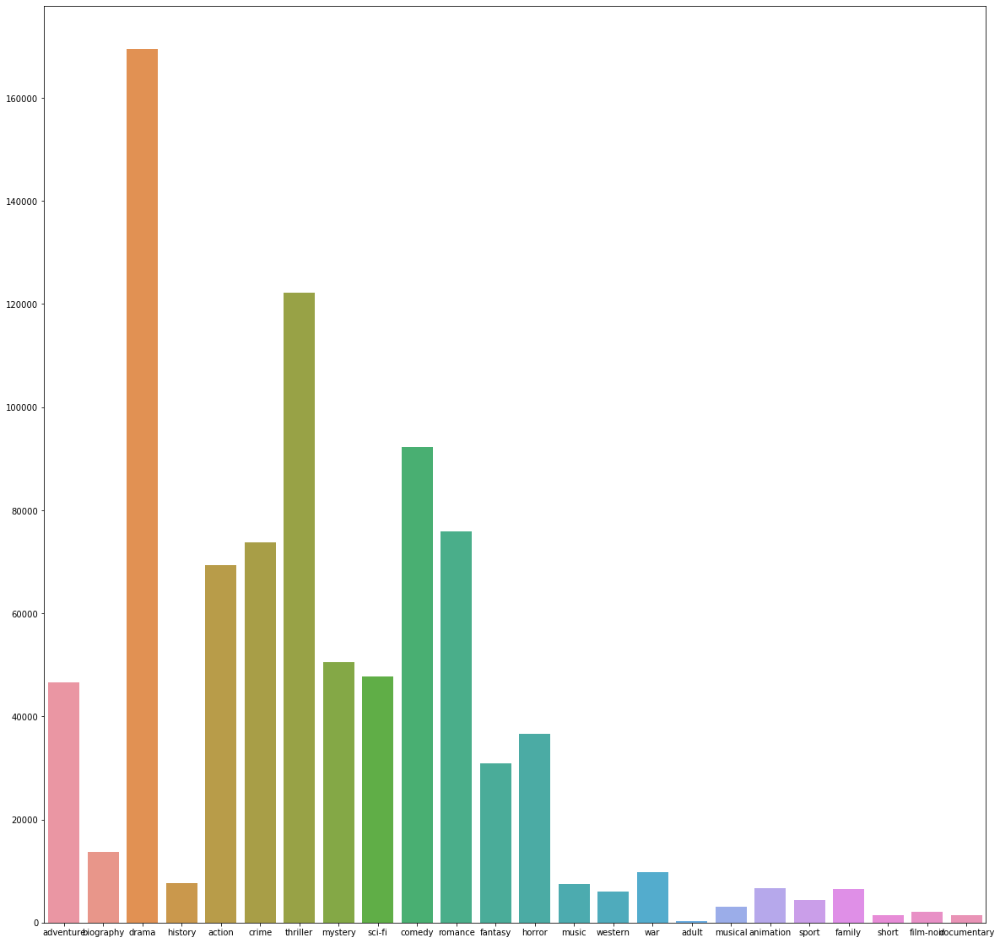

In [30]:

import matplotlib.pyplot as plt
keys = list(genre_dict.keys())
# get values in the same order as keys, and parse percentage values
val=[]
for i in keys:
    val.append(genre_dict[i])
fig, ax = plt.subplots()
# the size of A4 paper
fig.set_size_inches(20, 20)

sns.barplot(x=keys, y=val)    

##### We visualise the genres as pie plot also

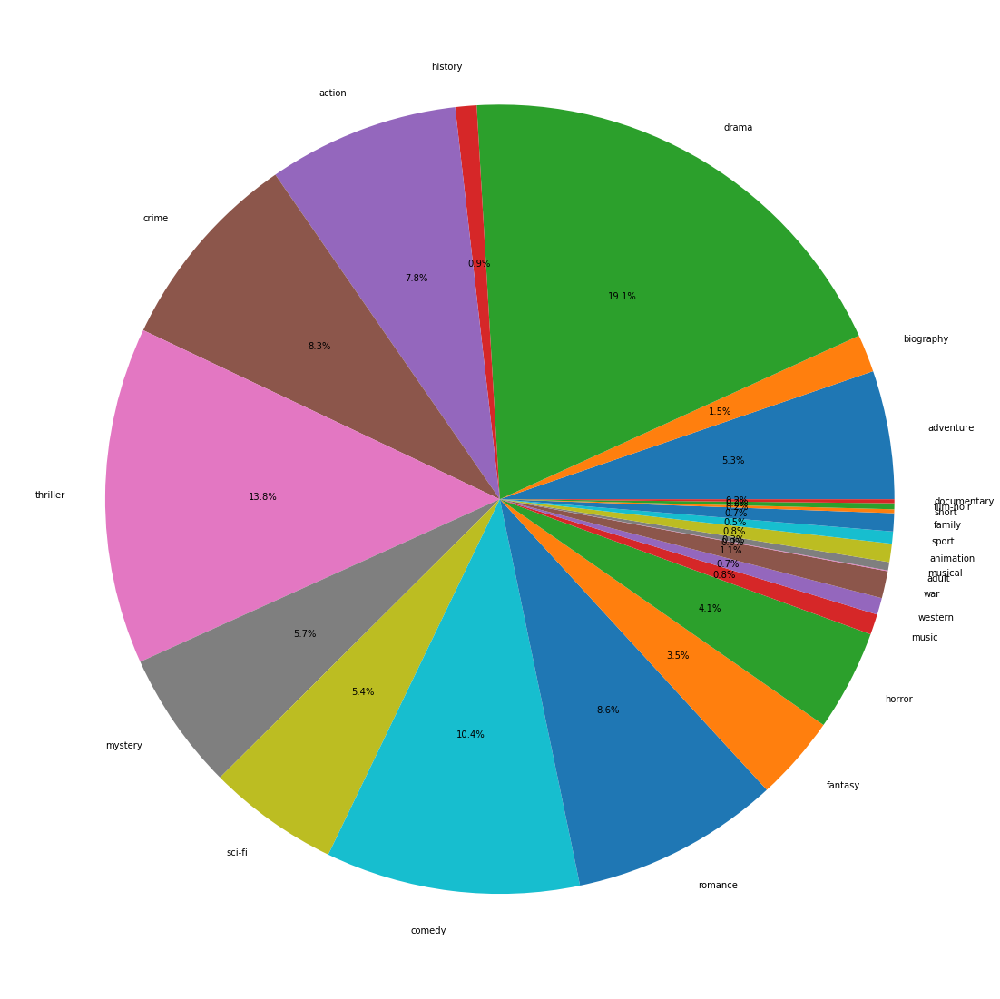

In [31]:

fig, ax = plt.subplots()
# the size of A4 paper
fig.set_size_inches(20, 20)

plt.pie(x=val, autopct="%.1f%%", labels=keys)
plt.show()

In [32]:
#Separate the labelled data on gender column from unlabelled ones
df_final_clean=df_final[(df_final["gender"]=="M") | (df_final["gender"]=="F")]

In [33]:
df_final_clean.head()

,characterID,character name,movieID,movie title,gender,position in credits,lineID,text of the utterance,movie year,IMDB rating,IMDB votes,genre
39,u16,COLUMBUS,m1,1492: conquest of paradise,M,1,L2024,Asia can be found to the west -- and I will pr...,1992,6.2,10421.0,"[adventure, biography, drama, history]"
40,u16,COLUMBUS,m1,1492: conquest of paradise,M,1,L2023,Blind faith is what I consider heresy!,1992,6.2,10421.0,"[adventure, biography, drama, history]"
41,u16,COLUMBUS,m1,1492: conquest of paradise,M,1,L2020,Did He not choose a carpenter's son to reveal ...,1992,6.2,10421.0,"[adventure, biography, drama, history]"
42,u16,COLUMBUS,m1,1492: conquest of paradise,M,1,L2016,No. The Portuguese have already discovered bl...,1992,6.2,10421.0,"[adventure, biography, drama, history]"
43,u16,COLUMBUS,m1,1492: conquest of paradise,M,1,L2014,Trade Your Excellency. According to Marco Pol...,1992,6.2,10421.0,"[adventure, biography, drama, history]"


##### we want to display the male and female character dialogues as wordclouds

In [34]:

from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator


In [35]:
#We copy the male character dialogue column in a dataframe

text = df_final_clean[df_final_clean["gender"]=="M"]["text of the utterance"]

In [36]:
li_text=[]

In [37]:
#We go through the column of the dataframe and copy the dialogues in a list
for i in text:
    li_text.append(i)

In [38]:
#We display the list of dialogues
li_text

['Asia can be found to the west -- and I will prove it.',
 'Blind faith is what I consider heresy!',
 "Did He not choose a carpenter's son to reveal Himself to the world?",
 'No.  The Portuguese have already discovered black-skinned people.  I too will find other populations -- and bring them to the word of God.',
 'Trade Your Excellency.  According to Marco Polo the Kingdom of China is one of the richest of the world. Even the meanest buildings are roofed with gold.',
 'If they agree to follow me yes.',
 'Your Eminence there is only one way to settle the matter.  And that is to make the journey.  I am ready to risk my life to prove it possible.',
 'Excellency you are right.',
 'I am Your Eminence',
 'Yes your Eminence.  The voyage should not take more than six or seven weeks.',
 "I can't keep my eyes off you.  I would like to catch up with all the moments I didn't spend with you.",
 "Can't you stay with us a little?",
 "Not everything... Do you think I care?  I'm a free man again.  Ri

In [39]:
# Download the English stopwords like 'a','the','is','are' which commonly occur in English text
import nltk
nltk.download('stopwords')
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords 
# word_tokenize accepts
# a string as an input, not a file.
stop_words = set(stopwords.words('english'))

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\indra\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [40]:
#We print the stopwords
stop_words

{'a',
 'about',
 'above',
 'after',
 'again',
 'against',
 'ain',
 'all',
 'am',
 'an',
 'and',
 'any',
 'are',
 'aren',
 "aren't",
 'as',
 'at',
 'be',
 'because',
 'been',
 'before',
 'being',
 'below',
 'between',
 'both',
 'but',
 'by',
 'can',
 'couldn',
 "couldn't",
 'd',
 'did',
 'didn',
 "didn't",
 'do',
 'does',
 'doesn',
 "doesn't",
 'doing',
 'don',
 "don't",
 'down',
 'during',
 'each',
 'few',
 'for',
 'from',
 'further',
 'had',
 'hadn',
 "hadn't",
 'has',
 'hasn',
 "hasn't",
 'have',
 'haven',
 "haven't",
 'having',
 'he',
 'her',
 'here',
 'hers',
 'herself',
 'him',
 'himself',
 'his',
 'how',
 'i',
 'if',
 'in',
 'into',
 'is',
 'isn',
 "isn't",
 'it',
 "it's",
 'its',
 'itself',
 'just',
 'll',
 'm',
 'ma',
 'me',
 'mightn',
 "mightn't",
 'more',
 'most',
 'mustn',
 "mustn't",
 'my',
 'myself',
 'needn',
 "needn't",
 'no',
 'nor',
 'not',
 'now',
 'o',
 'of',
 'off',
 'on',
 'once',
 'only',
 'or',
 'other',
 'our',
 'ours',
 'ourselves',
 'out',
 'over',
 'own',
 'r

In [41]:
#We split every dialogue into words and append to a list called li_word
li_word=[]
for i in li_text:
    x=str(i).lower()
    word=x.split(" ")
    for j in word:
        if j.isalpha():
            li_word.append(j)

In [42]:
#display list of words
li_word

['asia',
 'can',
 'be',
 'found',
 'to',
 'the',
 'west',
 'and',
 'i',
 'will',
 'prove',
 'blind',
 'faith',
 'is',
 'what',
 'i',
 'consider',
 'did',
 'he',
 'not',
 'choose',
 'a',
 'son',
 'to',
 'reveal',
 'himself',
 'to',
 'the',
 'the',
 'portuguese',
 'have',
 'already',
 'discovered',
 'i',
 'too',
 'will',
 'find',
 'other',
 'populations',
 'and',
 'bring',
 'them',
 'to',
 'the',
 'word',
 'of',
 'trade',
 'your',
 'according',
 'to',
 'marco',
 'polo',
 'the',
 'kingdom',
 'of',
 'china',
 'is',
 'one',
 'of',
 'the',
 'richest',
 'of',
 'the',
 'even',
 'the',
 'meanest',
 'buildings',
 'are',
 'roofed',
 'with',
 'if',
 'they',
 'agree',
 'to',
 'follow',
 'me',
 'your',
 'eminence',
 'there',
 'is',
 'only',
 'one',
 'way',
 'to',
 'settle',
 'the',
 'and',
 'that',
 'is',
 'to',
 'make',
 'the',
 'i',
 'am',
 'ready',
 'to',
 'risk',
 'my',
 'life',
 'to',
 'prove',
 'it',
 'excellency',
 'you',
 'are',
 'i',
 'am',
 'your',
 'eminence',
 'yes',
 'your',
 'the',
 'v

In [43]:
len(li_word)

1308084

In [44]:
#Remove stop_words from the list of words
li_word1=[]
for i in li_word:
    if i not in stop_words:
        li_word1.append(i)

In [45]:
li_word1

['asia',
 'found',
 'west',
 'prove',
 'blind',
 'faith',
 'consider',
 'choose',
 'son',
 'reveal',
 'portuguese',
 'already',
 'discovered',
 'find',
 'populations',
 'bring',
 'word',
 'trade',
 'according',
 'marco',
 'polo',
 'kingdom',
 'china',
 'one',
 'richest',
 'even',
 'meanest',
 'buildings',
 'roofed',
 'agree',
 'follow',
 'eminence',
 'one',
 'way',
 'settle',
 'make',
 'ready',
 'risk',
 'life',
 'prove',
 'excellency',
 'eminence',
 'yes',
 'voyage',
 'take',
 'six',
 'seven',
 'keep',
 'eyes',
 'would',
 'like',
 'catch',
 'moments',
 'spend',
 'stay',
 'us',
 'think',
 'free',
 'man',
 'riches',
 'make',
 'man',
 'rich',
 'make',
 'believe',
 'man',
 'ever',
 'taken',
 'away',
 'arrange',
 'queen',
 'take',
 'fernando',
 'diego',
 'beatrix',
 'want',
 'ask',
 'want',
 'wait',
 'said',
 'perhaps',
 'never',
 'meant',
 'live',
 'going',
 'given',
 'much',
 'could',
 'gone',
 'could',
 'mainland',
 'exactly',
 'said',
 'far',
 'free',
 'search',
 'appointment',
 'barto

In [46]:
li_word1.sort()
li_word1

['aa',
 'aa',
 'aaaaaaaaaaaa',
 'aaaaawww',
 'aaaah',
 'aaaahhhh',
 'aaah',
 'aaah',
 'aaah',
 'aaahhh',
 'aaaww',
 'aah',
 'aah',
 'aah',
 'aah',
 'aah',
 'aah',
 'aah',
 'aah',
 'aah',
 'aap',
 'aardvark',
 'aardvark',
 'aaron',
 'aaron',
 'aaron',
 'aaron',
 'aaron',
 'aaron',
 'ab',
 'abandon',
 'abandon',
 'abandon',
 'abandon',
 'abandon',
 'abandon',
 'abandon',
 'abandon',
 'abandon',
 'abandon',
 'abandon',
 'abandon',
 'abandon',
 'abandon',
 'abandon',
 'abandon',
 'abandon',
 'abandon',
 'abandon',
 'abandon',
 'abandoned',
 'abandoned',
 'abandoned',
 'abandoned',
 'abandoned',
 'abandoned',
 'abandoned',
 'abandoned',
 'abandoned',
 'abandoned',
 'abandoned',
 'abandoned',
 'abandoned',
 'abandoned',
 'abandoned',
 'abandoned',
 'abandoned',
 'abandoned',
 'abandoned',
 'abandoned',
 'abandoned',
 'abandoned',
 'abandonment',
 'abandonment',
 'abattoir',
 'abbe',
 'abbe',
 'abbe',
 'abbott',
 'abby',
 'abc',
 'abc',
 'abdicate',
 'abdomen',
 'abdominal',
 'abdominal',
 'a

In [47]:
#removing duplicates from the list of words by converting to a set and then again to a list
li_unique=list(set(li_word1))
li_unique.sort()
li_unique

['aa',
 'aaaaaaaaaaaa',
 'aaaaawww',
 'aaaah',
 'aaaahhhh',
 'aaah',
 'aaahhh',
 'aaaww',
 'aah',
 'aap',
 'aardvark',
 'aaron',
 'ab',
 'abandon',
 'abandoned',
 'abandonment',
 'abattoir',
 'abbe',
 'abbott',
 'abby',
 'abc',
 'abdicate',
 'abdomen',
 'abdominal',
 'abduct',
 'abducted',
 'abduction',
 'abducts',
 'abdul',
 'abe',
 'aber',
 'aberdeen',
 'abernathy',
 'aberration',
 'abetting',
 'abhor',
 'abhorrent',
 'abide',
 'abilities',
 'ability',
 'able',
 'ablest',
 'ablutions',
 'abnormal',
 'abnormality',
 'abnormally',
 'aboard',
 'abolish',
 'abolished',
 'abominable',
 'abomination',
 'aboot',
 'abort',
 'aborted',
 'abortion',
 'abouta',
 'aboveboard',
 'abraham',
 'abrams',
 'abreast',
 'abroad',
 'abrupt',
 'abs',
 'absence',
 'absent',
 'absenting',
 'absently',
 'absolut',
 'absolute',
 'absolutely',
 'absolved',
 'absorb',
 'absorbed',
 'absorbing',
 'absorption',
 'abstract',
 'abstraction',
 'abstractions',
 'absurd',
 'absurde',
 'abu',
 'abundance',
 'abundantly

In [48]:
#Add the list of words in a string
str_list=" "
str_list=str_list.join(li_unique)
str_list

'aa aaaaaaaaaaaa aaaaawww aaaah aaaahhhh aaah aaahhh aaaww aah aap aardvark aaron ab abandon abandoned abandonment abattoir abbe abbott abby abc abdicate abdomen abdominal abduct abducted abduction abducts abdul abe aber aberdeen abernathy aberration abetting abhor abhorrent abide abilities ability able ablest ablutions abnormal abnormality abnormally aboard abolish abolished abominable abomination aboot abort aborted abortion abouta aboveboard abraham abrams abreast abroad abrupt abs absence absent absenting absently absolut absolute absolutely absolved absorb absorbed absorbing absorption abstract abstraction abstractions absurd absurde abu abundance abundantly abuse abused abuses abusing abut ac acacia acacias academic academies academy acapulco accelerate accelerated acceleration accelerator accent accents accept acceptable acceptance accepted accepting accepts accesory access accessed accessible accessing accessory accident accidental accidentally accidentaly accidente accidently 

##### We display a wordcloud which depicts and emphasizes some most important words used in the dialogues by male character

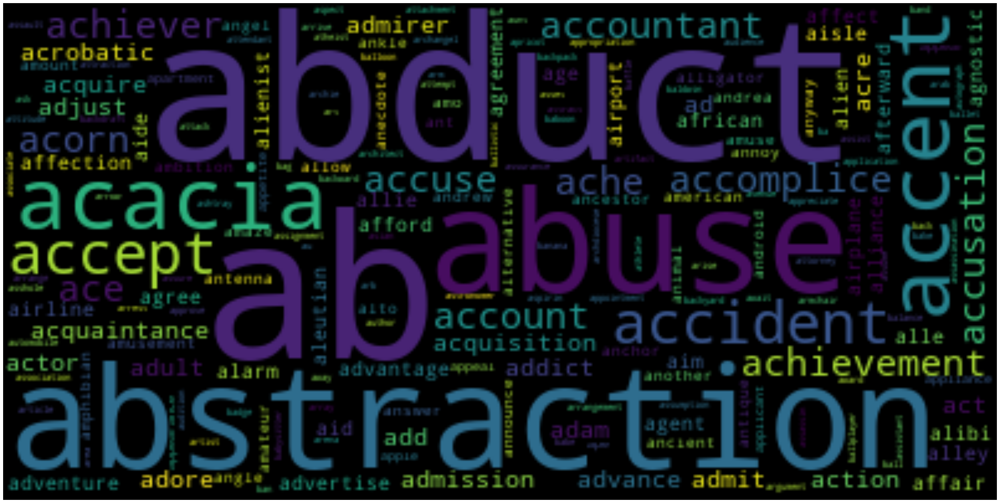

In [49]:

wordcloud = WordCloud().generate(str_list)
plt.figure( figsize=(40,40) )
# Display the generated image:
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

##### We print the wordcloud same process as above with the dialogues of the female character

In [50]:
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
text = df_final_clean[df_final_clean["gender"]=="F"]["text of the utterance"]
li_text2=[]
for i in text:
    li_text2.append(i)

In [51]:
li_word_female=[]
for i in li_text2:
    x=str(i).lower()
    word=x.split(" ")
    for j in word:
        if j.isalpha():
            li_word_female.append(j)

In [52]:
li_word_female1=[]
for i in li_word_female:
    if i not in stop_words:
        li_word_female1.append(i)

In [53]:
#removing duplicates
li_unique_f=list(set(li_word_female1))
li_unique_f.sort()
li_unique_f

['aa',
 'aaaaaaaaaaaaaa',
 'aaah',
 'aaand',
 'aaron',
 'ab',
 'abandon',
 'abandoned',
 'abbe',
 'abbot',
 'abbott',
 'abduct',
 'abducted',
 'abetting',
 'abide',
 'ability',
 'able',
 'abnormal',
 'aboard',
 'abolishment',
 'abort',
 'abortion',
 'abortionist',
 'abroad',
 'absence',
 'absolute',
 'absolutely',
 'absorb',
 'absorbed',
 'abstinence',
 'abstracts',
 'absurd',
 'absurdity',
 'abuse',
 'abused',
 'abyss',
 'abyssal',
 'abyssinian',
 'academic',
 'academy',
 'acapulco',
 'accelerated',
 'accelerating',
 'accent',
 'accents',
 'accentuate',
 'accept',
 'acceptable',
 'acceptance',
 'accepted',
 'accepting',
 'accepts',
 'access',
 'accessory',
 'accident',
 'accidentally',
 'accidently',
 'accidents',
 'acclimate',
 'accompany',
 'accompanying',
 'accomplish',
 'accomplished',
 'accomplishing',
 'accomplishment',
 'accord',
 'accordance',
 'according',
 'account',
 'accountant',
 'accounted',
 'accounting',
 'accounts',
 'accredited',
 'accumulate',
 'accurate',
 'accusat

In [54]:
str_list_f=" "
str_list_f=str_list_f.join(li_unique_f)
str_list_f

'aa aaaaaaaaaaaaaa aaah aaand aaron ab abandon abandoned abbe abbot abbott abduct abducted abetting abide ability able abnormal aboard abolishment abort abortion abortionist abroad absence absolute absolutely absorb absorbed abstinence abstracts absurd absurdity abuse abused abyss abyssal abyssinian academic academy acapulco accelerated accelerating accent accents accentuate accept acceptable acceptance accepted accepting accepts access accessory accident accidentally accidently accidents acclimate accompany accompanying accomplish accomplished accomplishing accomplishment accord accordance according account accountant accounted accounting accounts accredited accumulate accurate accusations accuse accused accusing accustomed ace aches achieve achieved achievement achievements achilles achingly acid acitizen ackerman acknowledge acknowledging acl acme acne acorn acquaintance acquainted acquiesce acquire acquired acquisition across act acted acting action actions activate activated activ

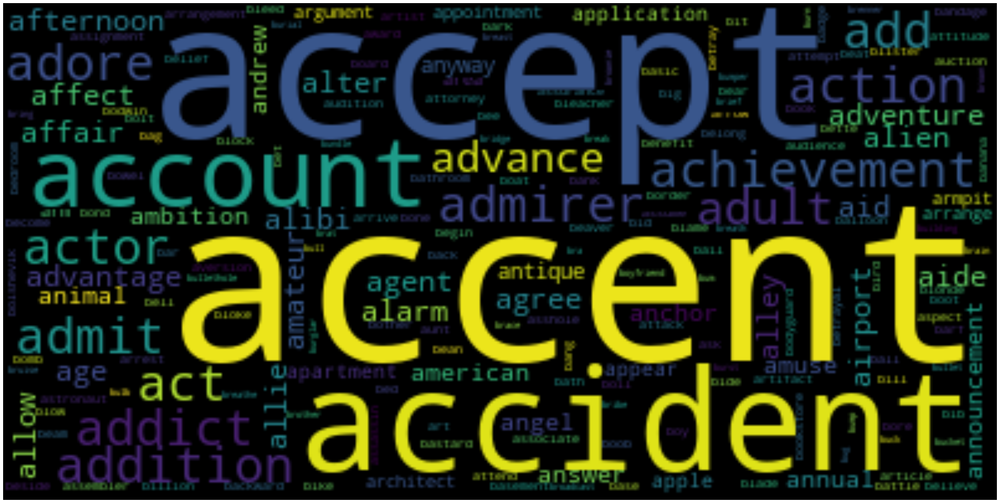

In [55]:
wordcloud = WordCloud().generate(str_list_f)
plt.figure( figsize=(40,40) )
# Display the generated image:
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

# Preparing to create classifier

In [56]:
df_final_clean.head()

,characterID,character name,movieID,movie title,gender,position in credits,lineID,text of the utterance,movie year,IMDB rating,IMDB votes,genre
39,u16,COLUMBUS,m1,1492: conquest of paradise,M,1,L2024,Asia can be found to the west -- and I will pr...,1992,6.2,10421.0,"[adventure, biography, drama, history]"
40,u16,COLUMBUS,m1,1492: conquest of paradise,M,1,L2023,Blind faith is what I consider heresy!,1992,6.2,10421.0,"[adventure, biography, drama, history]"
41,u16,COLUMBUS,m1,1492: conquest of paradise,M,1,L2020,Did He not choose a carpenter's son to reveal ...,1992,6.2,10421.0,"[adventure, biography, drama, history]"
42,u16,COLUMBUS,m1,1492: conquest of paradise,M,1,L2016,No. The Portuguese have already discovered bl...,1992,6.2,10421.0,"[adventure, biography, drama, history]"
43,u16,COLUMBUS,m1,1492: conquest of paradise,M,1,L2014,Trade Your Excellency. According to Marco Pol...,1992,6.2,10421.0,"[adventure, biography, drama, history]"


In [57]:
#We copied the numeric columns along with the dialogues in a new dataframe for training
df_classifier=df_final_clean.iloc[:,[5,7,9,10,4]]

In [58]:
df_classifier.head()

,position in credits,text of the utterance,IMDB rating,IMDB votes,gender
39,1,Asia can be found to the west -- and I will pr...,6.2,10421.0,M
40,1,Blind faith is what I consider heresy!,6.2,10421.0,M
41,1,Did He not choose a carpenter's son to reveal ...,6.2,10421.0,M
42,1,No. The Portuguese have already discovered bl...,6.2,10421.0,M
43,1,Trade Your Excellency. According to Marco Pol...,6.2,10421.0,M


In [59]:
#we created a new column with the number of characters of the dialogue
df_classifier["len_dialogue"]=df_classifier["text of the utterance"].str.len()

C:\Users\indra\anaconda3\lib\site-packages\pandas\core\frame.py:3607: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._set_item(key, value)


In [60]:
#we created a new column with the number of words present in the dialogue
df_classifier['wordCount'] = df_classifier["text of the utterance"].str.count(' ') + 1

In [61]:
df_classifier.head()

,position in credits,text of the utterance,IMDB rating,IMDB votes,gender,len_dialogue,wordCount
39,1,Asia can be found to the west -- and I will pr...,6.2,10421.0,M,53.0,13.0
40,1,Blind faith is what I consider heresy!,6.2,10421.0,M,38.0,7.0
41,1,Did He not choose a carpenter's son to reveal ...,6.2,10421.0,M,67.0,13.0
42,1,No. The Portuguese have already discovered bl...,6.2,10421.0,M,138.0,25.0
43,1,Trade Your Excellency. According to Marco Pol...,6.2,10421.0,M,153.0,28.0


In [64]:
#To convert position in credits to numeric we need to filter out the unlabelled entries(entries containing ?)
import numpy as np
df_classifier[df_classifier["position in credits"]!="?"]["position in credits"].astype(np.float)
    

39        1.0
40        1.0
41        1.0
42        1.0
43        1.0
         ... 
298945    9.0
298946    9.0
298947    9.0
298948    9.0
298949    9.0
Name: position in credits, Length: 212210, dtype: float64

In [65]:
df_classifier["position in credits"].value_counts()

1       78455
2       45713
3       25540
?       25252
4       15127
5       10293
6        8365
8        4665
7        4580
9        2981
10       1831
1000     1461
11       1387
13       1362
16       1294
12       1278
14       1010
19        860
18        798
17        667
21        643
15        518
45        462
35        316
22        261
20        252
25        235
27        203
29        171
26        167
24        127
23        124
43        112
38        108
44        106
33         69
31         67
30         59
41         47
34         45
39         40
42         39
59         37
51         32
62         32
70         31
71         30
32         30
36         29
28         27
63         24
47         20
37         19
82         17
46         16
50         15
49         13
Name: position in credits, dtype: int64

In [67]:
#we will replace the ? with the mean of the numeric values
mean_credit=np.mean(df_classifier[df_classifier["position in credits"]!="?"]["position in credits"])
mean_credit

10.582559728570756

In [68]:
#Filling missiong values with the mean

df_classifier["position in credits"]=df_classifier["position in credits"].replace("?",mean_credit)

C:\Users\indra\anaconda3\lib\site-packages\pandas\core\frame.py:3607: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._set_item(key, value)


In [69]:
df_classifier["position in credits"].value_counts()

1.00000       78455
2.00000       45713
3.00000       25540
10.58256      25252
4.00000       15127
5.00000       10293
6.00000        8365
8.00000        4665
7.00000        4580
9.00000        2981
10.00000       1831
1000.00000     1461
11.00000       1387
13.00000       1362
16.00000       1294
12.00000       1278
14.00000       1010
19.00000        860
18.00000        798
17.00000        667
21.00000        643
15.00000        518
45.00000        462
35.00000        316
22.00000        261
20.00000        252
25.00000        235
27.00000        203
29.00000        171
26.00000        167
24.00000        127
23.00000        124
43.00000        112
38.00000        108
44.00000        106
33.00000         69
31.00000         67
30.00000         59
41.00000         47
34.00000         45
39.00000         40
42.00000         39
59.00000         37
51.00000         32
62.00000         32
70.00000         31
71.00000         30
32.00000         30
36.00000         29
28.00000         27


In [75]:
#Construction a tf idf vector( tf stands for term frequency and idf stands for inverse document frequency) 
from sklearn.feature_extraction.text import TfidfVectorizer
tfidfconverter = TfidfVectorizer(max_features=1500, min_df=5, max_df=0.7, stop_words=stopwords.words('english'))
X_vector = tfidfconverter.fit_transform(df_classifier["text of the utterance"].values.astype('U')).toarray()

In [77]:
X_vector

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [78]:
y=df_classifier.gender

In [80]:
# We train machine with this tf-idf vector
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X_vector, y, test_size=0.2, random_state=0)

In [83]:
# creating a 
from sklearn.ensemble import RandomForestClassifier
RANDOM_SEED=100
model_rf= RandomForestClassifier(n_estimators=10, random_state=RANDOM_SEED)

model_rf.fit(X_train, y_train)
#scores=cross_val_score(model3,x,y,cv=5,scoring='f1_micro')



RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=10,
                       n_jobs=None, oob_score=False, random_state=100,
                       verbose=0, warm_start=False)

In [ ]:
from sklearn.model_selection import cross_val_score,cross_val_predict
from sklearn.metrics import confusion_matrix
#We perform prediction with cross validation. In cross validation the traning set is splitted and shuffled
p_test_model_rf=cross_val_predict(model_rf,X_test,y_test,cv=5)
#validating the model with confusion matrix
table_cross=confusion_matrix(y_test,p_test_model_rf)
print(table_cross)
#We print the accuracy score which shows as 67%
from sklearn.metrics import accuracy_score
accuracy = accuracy_score(y_test,p_test_model_rf)
accuracy


In [ ]:
accuracy